# Analysis of Cancer Stroma Interface in Xenium

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload



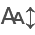

In [15]:
%load_ext autoreload

import os 
import sys
import time
import logging
import re
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import json
import anndata as ad
import scanpy as sc
from natsort import natsorted
import itables
from itables import show
import numpy as np
np.random.seed(42)
itables.init_notebook_mode(all_interactive=True)

sys.path.append('../../')
# sys.path.append('..')
import seaborn as sns
from GRIDGEN.src import get_arrays as ga
from GRIDGEN.src import contours 
from GRIDGEN.src import masks
from GRIDGEN.src.mask_properties import GetMasksProperties

In [3]:
# define the logger :  can be None, and is set to INFO
# Custom logger setup
logger = logging.getLogger('contour_logger')
handler = logging.StreamHandler()
formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
handler.setFormatter(formatter)
logger.addHandler(handler)
logger.setLevel(logging.INFO)

Get the files for Xenium

In [4]:
tma1_path = '../../xenium_data/HLA/GD_TMA1_S3/fov_filtered'
files_tma1 = os.listdir(tma1_path)


to_exclude = [
    'TMA1_Selection14_filtered.csv' , # little tumour
    'TMA1_Selection15_filtered.csv', # tonsil
    'TMA1_Selection18_filtered.csv' , # normal
    'TMA1_Selection24_filtered.csv', # tonsl 
    'TMA1_Selection27_filtered.csv', # low quality
    'TMA1_Selection32_filtered.csv', # low quality
    'TMA1_Selection33_filtered.csv', # low quality
             ]

files = [os.path.join(tma1_path, file) for file in files_tma1 if file not in to_exclude]
print(len(files))

metadata_file = '../../xenium_data/HLA/map_HLA_19_09_2024.xlsx'
metadata = pd.read_excel(metadata_file)
metadata['name'] = metadata['XENIUM_TMA'] + '_' + metadata['Selection'].str.replace(' ', '')
metadata = metadata.loc[metadata["XENIUM_TMA"] == "TMA1"]
metadata.head()

20


,XENIUM_TMA,Selection,annotation,Hes,TMA,COSMX selection,Case,Block,Unnamed: 8,MMR,HLA,B2M abcam,IHC group,B2M gene defect,Final group,name
0,TMA1,Selection 7,NaN,yes,GD_TMA1,COSMX,17/H15722,1I,S00159,MMRd,negative,mut pattern,HLA defect,no mutation,HLA defect,TMA1_Selection7
1,TMA1,Selection 8,NaN,yes,GD_TMA1,COSMX,17/H15137,1G,S00154,MMRd,positive,positive,HLA+,no mutation,HLA+,TMA1_Selection8
2,TMA1,Selection 9,NaN,yes,GD_TMA1,COSMX,17/H09934,1M,S00120,MMRd,positive,positive,HLA+,NaN,HLA+,TMA1_Selection9
3,TMA1,Selection 11,NaN,yes,GD_TMA1,COSMX,17/H08334,1E,S00102,MMRd,negative,positive,HLA defect,mutation (exon 2),B2M defect,TMA1_Selection11
4,TMA1,Selection 12,NaN,yes,GD_TMA1,COSMX,17/H07092,1AD,S00096,MMRd,cytoplasmic,negative,B2M defect,mutation (exon 1),B2M defect,TMA1_Selection12


# Apply GRIDGEN to Xenium to derive Cancer and Stroma masks

First Cancer and Stroma masks are derived (similar to the previous notebook: "Cancer Stroma in Xenium"). After this, expansions from the cancer mask through the stroma mask are derived. In the end, we will retrieve the mask information.
We will show this in one example first and then apply to the cohort.

In [5]:
# defined with the gene list f
target_tum = ['EPCAM', 'SMIM22','CLDN3', 'KRT18','LGALS4', 'KRT8', 'ELF3','TSPAN8', 'STMN1', 'CD47', 'MYC', 'LGALS3'] 

# param tum
density_th_tum = 10    # 50  30
min_area_th_tum =  700 #1000     check how much is a cell 
kernel_size_tum = 10   # 20

# param empty
density_th_empty = 40
min_area_th_empty = 400 #400
kernel_size_empty = 10

df shape (2084362, 5)
shape 1817 1817 480
Function 'get_conv_sum' took 0.0798 seconds to execute.
Function 'contours_from_sum' took 0.5417 seconds to execute.
Function 'get_conv_sum' took 0.6186 seconds to execute.
Function 'contours_from_sum' took 6.4806 seconds to execute.


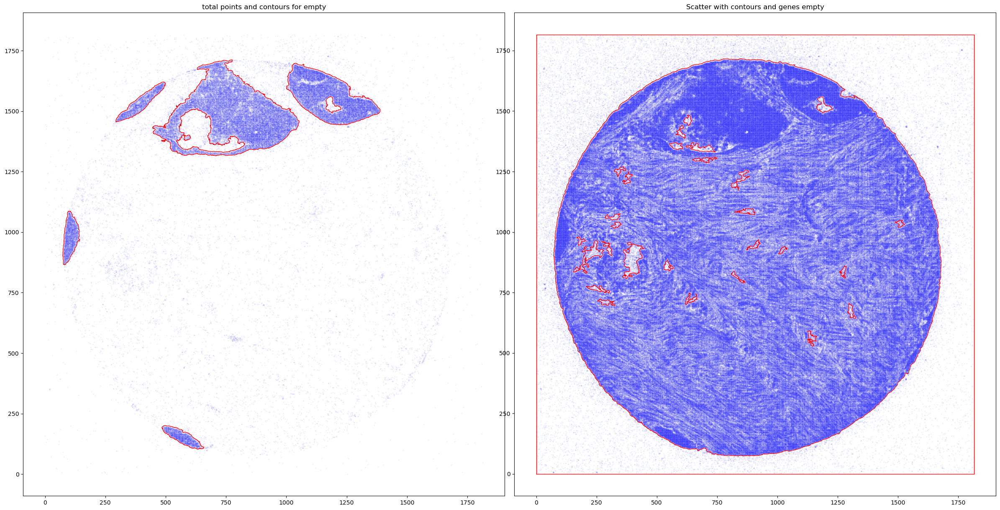

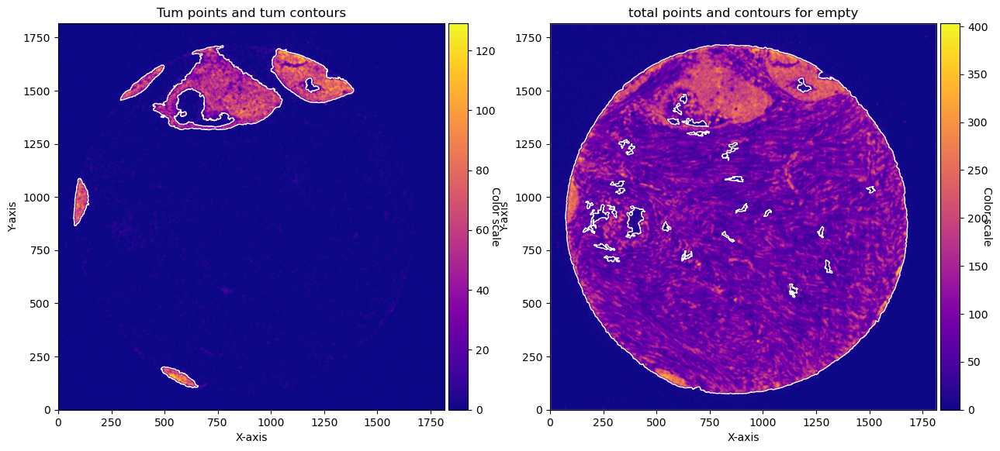

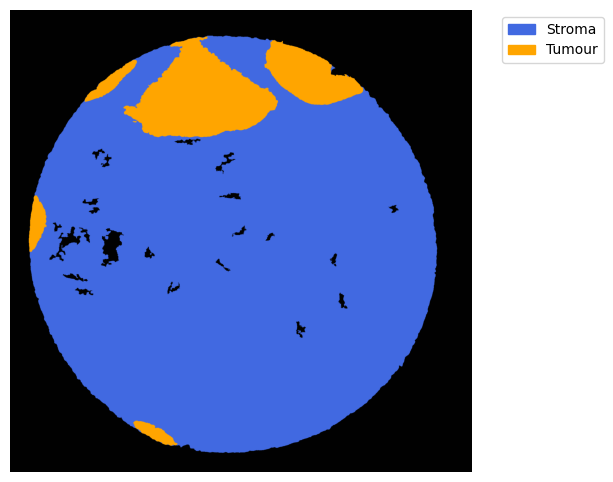

In [9]:
file_csv = files[9]
df_total = pd.read_csv(file_csv)
df_total = df_total[['x_location', 'y_location', 'feature_name']]
df_total = df_total.rename(columns={'feature_name': 'target'})
df_total = df_total[~df_total['target'].str.contains('System|egative')]
df_total['X'] = df_total['x_location'] - min(df_total['x_location'])
df_total['Y'] = df_total['y_location'] - min(df_total['y_location'])

n_genes = len(df_total['target'].unique())
height = int(max(df_total['X'])) + 1
width = int(max(df_total['Y'])) + 1

print('df shape', df_total.shape)
print('shape',height,width,n_genes)

# this makes the sparse df to an array with the spatial information 
target_dict_total = {target: index for index, target in enumerate(df_total['target'].unique())}
array_total = ga.transform_df_to_array(df = df_total, target_dict=target_dict_total, array_shape = (height, width,len(target_dict_total))).astype(np.int8)

# creating subsets 
df_subset_tum, array_subset_tum, target_indices_subset_tum = ga.get_subset_arrays(df_total, array_total,target_dict_total,
                                                                     target_list=target_tum, target_col = 'target')

# obtain contours 
CTum = contours.ConvolutionContours(array_subset_tum, contour_name='tum')
CTum.get_conv_sum(kernel_size=kernel_size_tum, kernel_shape='square')
CTum.contours_from_sum(density_threshold = density_th_tum,
                       min_area_threshold = min_area_th_tum , directionality = 'higher')

CEmpty = contours.ConvolutionContours(array_total, contour_name='empty')
CEmpty.get_conv_sum(kernel_size=kernel_size_empty, kernel_shape='square')
CEmpty.contours_from_sum(density_threshold = density_th_empty,
                       min_area_threshold = min_area_th_empty, directionality = 'lower') # attention that directionality is lower here 

# PLOTs -- instead of plotting just with the function for example: CTum.plot_contours_scatter, we will make a composite image 

fig, axs = plt.subplots(1, 2, figsize=(30, 15))
CTum.plot_contours_scatter(path=None, show=False, s=0.05, alpha=0.5, linewidth=1,
                           c_points= 'blue',c_contours= 'red', ax=axs[0])
axs[0].set_title('Tum points and tum contours')  


CEmpty.plot_contours_scatter(path=None, show=False, s=0.05, alpha=0.5, linewidth=1,
                           c_points= 'blue',c_contours= 'red', ax=axs[1])
axs[0].set_title('total points and contours for empty')  
plt.subplots_adjust(wspace=0.02)  # Adjust to your preference

plt.show()


fig, axs = plt.subplots(1, 2, figsize=(15, 10))

CTum.plot_conv_sum(cmap='plasma', c_countour='white', ax=axs[0])
axs[0].set_title('Tum points and tum contours')

CEmpty.plot_conv_sum(cmap='plasma', c_countour='white', ax=axs[1])
axs[1].set_title('total points and contours for empty')

plt.show()



#### obtain masks
GM = masks.GetMasks(image_shape = (height, width))

mask_empty = GM.create_mask(CEmpty.contours)
mask_tum = GM.create_mask(CTum.contours)
mask_tum = GM.fill_holes(mask_tum)
mask_stroma = GM.subtract_masks(np.ones((height, width), dtype=np.uint8), mask_tum, mask_empty)          
mask_stroma = GM.filter_mask_by_area(mask_stroma, min_area=700)

# general masks 
GM.mask_S = mask_stroma
GM.mask_T = mask_tum

GM.plot_masks(masks=[GM.mask_S, GM.mask_T], mask_names=['Stroma', 'Tumour'],
              background_color=(1, 1, 1), mask_colors={'Stroma': (65, 105, 225), 'Tumour': (255, 165, 0)},
              path=None, show=True, ax=None, figsize=(8, 6)) 

Now with the Cancerand Stroma masks we will derive the interface. The interface is the Cancer regions expanded inside the stroma area. We will expand 10 and 20 um.  

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000


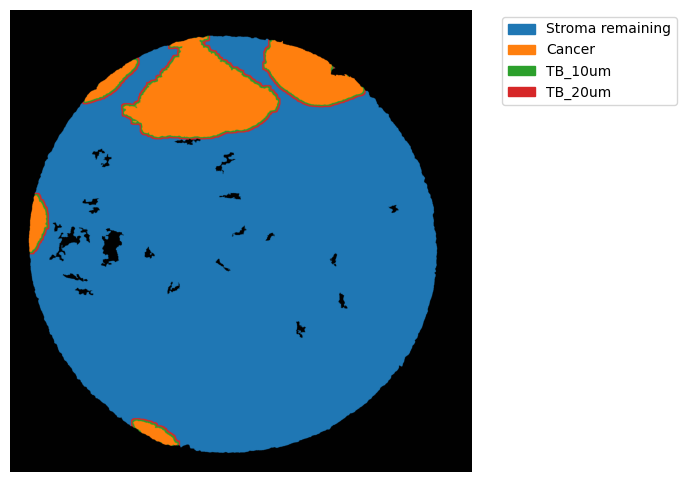

In [11]:
#### tumour border analysis
TA = masks.TumBorderAnalysis(GM)
TA.get_mask_tumour_border(expansions_pixels=[10, 20], filter_area=3000)
mask_stroma_tborder = TA.mask_S_tborder
mask_tumour_tborder = TA.mask_T_tborder  # will be the same as T overall
(mask_TB_10px, mask_TB_20px) = TA.mask_TB_tborders

mask_dict = {
    'mask_stroma_tborder': mask_stroma_tborder,
    'mask_tumour_tborder': mask_tumour_tborder,
    'mask_TB_10px': mask_TB_10px,
    'mask_TB_20px': mask_TB_20px,
}

GM.plot_masks(masks=mask_dict.values(),
              mask_names=['Stroma remaining', 'Cancer', 'TB_10um','TB_20um',],
              background_color=(1, 1, 1), mask_colors=None, path=None, show=True, ax=None,
             figsize=(8, 6))

Finally we can extract the information from the masks

In [7]:
masks_analysis_tb = [
    {'mask': TA.mask_S_tborder, 'mask_name': 'Stroma_remaining', 'per_object': False, 'level_hierarchy': None},
    {'mask': TA.mask_T_tborder, 'mask_name': 'tumour_remaining', 'per_object': False, 'level_hierarchy': None},
    {'mask': mask_TB_10px, 'mask_name': 'mask_TB_10um', 'per_object': False, 'level_hierarchy': None},
    {'mask': mask_TB_20px, 'mask_name': 'mask_TB_20um', 'per_object': False, 'level_hierarchy': None},

]

GP = GetMasksProperties(masks_dict = masks_analysis_tb,array_counts = array_total,
                        target_dict = target_dict_total,
                        logger = logger, image_shape = (height, width), save_path = None)

final_result = GP.get_gene_counts()
GP.check_counts()
final_result.head()

2025-05-26 17:39:12,352 - contour_logger - INFO - The run method took 4.274460554122925 seconds (0.07124100923538208 minutes) to execute
INFO:contour_logger:The run method took 4.274460554122925 seconds (0.07124100923538208 minutes) to execute
INFO:root:Positive values in array: 2045143
INFO:root:Sum of DataFrame: 2014606
INFO:root:Counts difference: 30537


Function 'get_gene_counts' took 4.2751 seconds to execute.


,mask_name,object_id,area,perimeter,centroid,min_x,min_y,max_x,max_y,vertices,...,CD45RO,IFNB1,IGHD,CD45RA,CCL19,CD7,EBI3,LST1,VPREB3,per_object
0,Stroma_remaining,0,1775025.0,13742.831955,"(891.3425636258644, 817.4966972296165)",75,77,1717,1680,1775025,...,46,41,6,3,42,14,32,0,8,False
1,mask_TB_10um,0,18596.0,7431.794657,"(713.369649386965, 1324.1067971606797)",103,76,1716,1394,18596,...,1,0,0,0,1,2,4,0,0,False
2,mask_TB_20um,0,19444.0,6932.505156,"(718.8643797572516, 1327.8018411849414)",103,78,1716,1399,19444,...,4,1,1,0,2,0,9,0,0,False
3,tumour_remaining,0,217909.0,5066.7417,"(806.730795882685, 1431.810122574102)",103,74,1713,1389,217909,...,17,23,6,0,17,10,11,1,4,False


We will now set up the code and apply the Cancer Stroma interface analysis to the cohort. 
We will save the results. 

Processing Folders:   0%|                                                                                                                                | 0/20 [00:00<?, ?folder/s]2025-05-29 11:09:23,073 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection23_filtered.csv


Function 'get_conv_sum' took 0.0791 seconds to execute.
Function 'contours_from_sum' took 2.0166 seconds to execute.
Function 'get_conv_sum' took 0.7086 seconds to execute.
Function 'contours_from_sum' took 4.8580 seconds to execute.


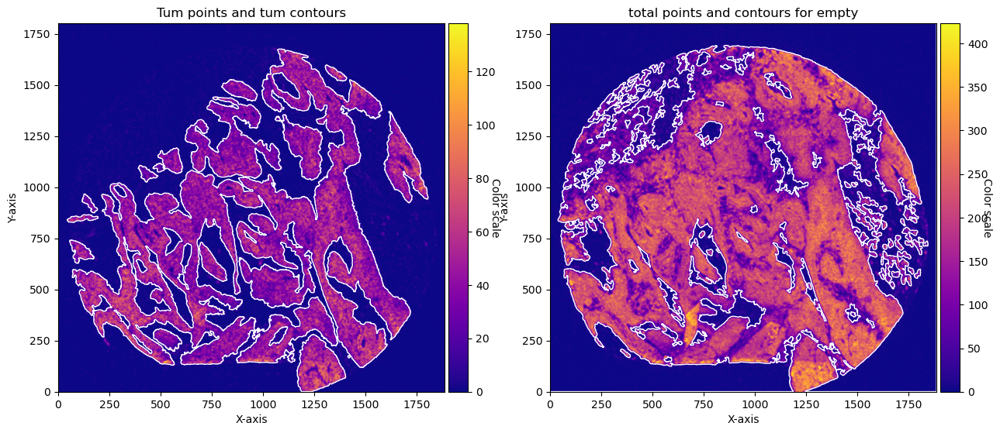

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection23/masks_stromaremaining_tumour_tb_10um_tb_20um.png


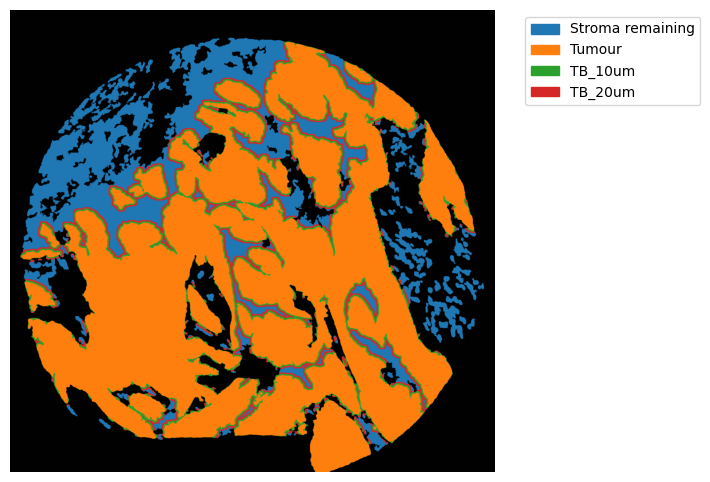

2025-05-29 11:09:44,131 - contour_logger - INFO - The run method took 4.512609481811523 seconds (0.07521015803019206 minutes) to execute
INFO:root:Positive values in array: 3225310
INFO:root:Sum of DataFrame: 3129204
INFO:root:Counts difference: 96106
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection23/TMA1_Selection23_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection23_filtered.csv in 21.197556495666504seconds
Processing Folders:   5%|██████                                                                                                                  | 1/20 [00:21<06:42, 21.20s/folder]2025-05-29 11:09:44,271 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection21_filtered.csv


Function 'get_gene_counts' took 4.5132 seconds to execute.
Function 'get_conv_sum' took 0.0786 seconds to execute.
Function 'contours_from_sum' took 4.9293 seconds to execute.
Function 'get_conv_sum' took 0.7008 seconds to execute.
Function 'contours_from_sum' took 5.8470 seconds to execute.


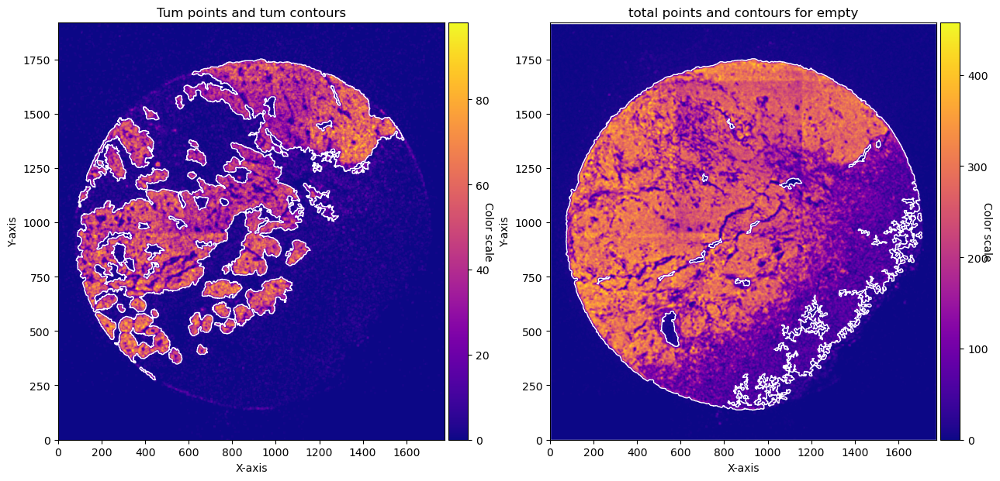

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection21/masks_stromaremaining_tumour_tb_10um_tb_20um.png


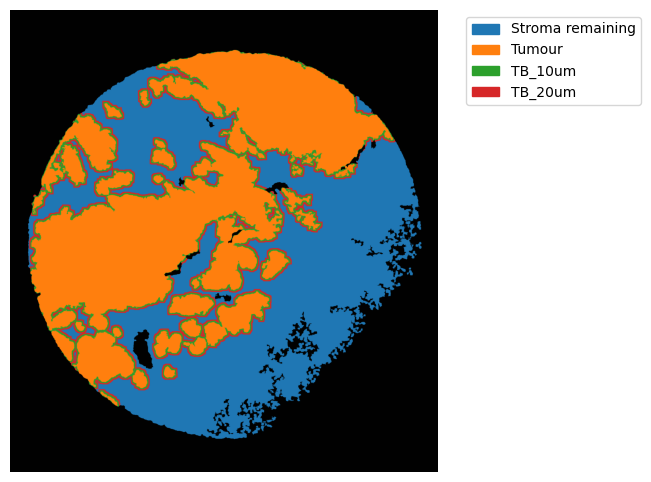

2025-05-29 11:10:09,392 - contour_logger - INFO - The run method took 4.6061553955078125 seconds (0.07676925659179687 minutes) to execute
INFO:root:Positive values in array: 3654830
INFO:root:Sum of DataFrame: 3591975
INFO:root:Counts difference: 62855
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection21/TMA1_Selection21_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection21_filtered.csv in 25.227980852127075seconds
Processing Folders:  10%|████████████                                                                                                            | 2/20 [00:46<07:04, 23.57s/folder]2025-05-29 11:10:09,499 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection17_filtered.csv


Function 'get_gene_counts' took 4.6066 seconds to execute.
Function 'get_conv_sum' took 0.0705 seconds to execute.
Function 'contours_from_sum' took 1.1880 seconds to execute.
Function 'get_conv_sum' took 0.5893 seconds to execute.
Function 'contours_from_sum' took 6.2334 seconds to execute.


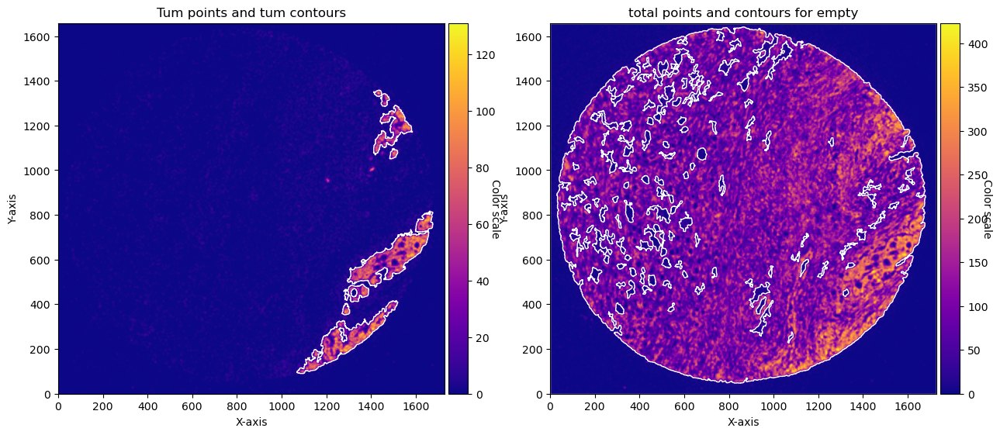

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection17/masks_stromaremaining_tumour_tb_10um_tb_20um.png


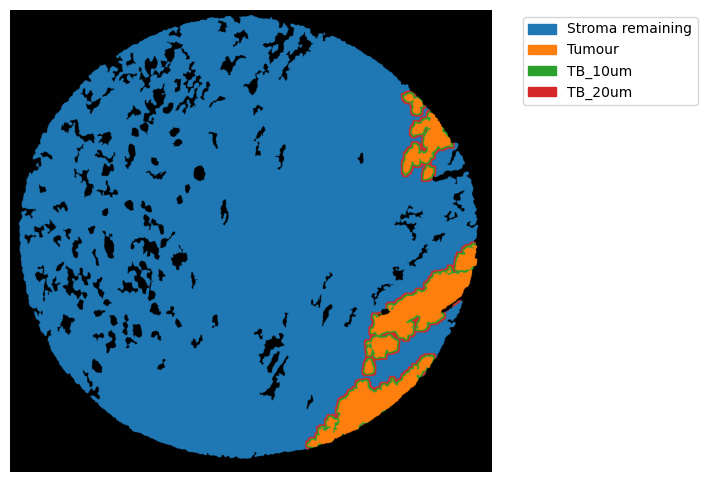

2025-05-29 11:10:28,415 - contour_logger - INFO - The run method took 3.8043997287750244 seconds (0.0634066621462504 minutes) to execute
INFO:root:Positive values in array: 2134797
INFO:root:Sum of DataFrame: 2085966
INFO:root:Counts difference: 48831
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection17/TMA1_Selection17_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection17_filtered.csv in 19.00682520866394seconds
Processing Folders:  15%|██████████████████                                                                                                      | 3/20 [01:05<06:05, 21.49s/folder]2025-05-29 11:10:28,507 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection31_filtered.csv


Function 'get_gene_counts' took 3.8051 seconds to execute.
Function 'get_conv_sum' took 0.0636 seconds to execute.
Function 'contours_from_sum' took 1.4041 seconds to execute.
Function 'get_conv_sum' took 0.5398 seconds to execute.
Function 'contours_from_sum' took 0.8001 seconds to execute.


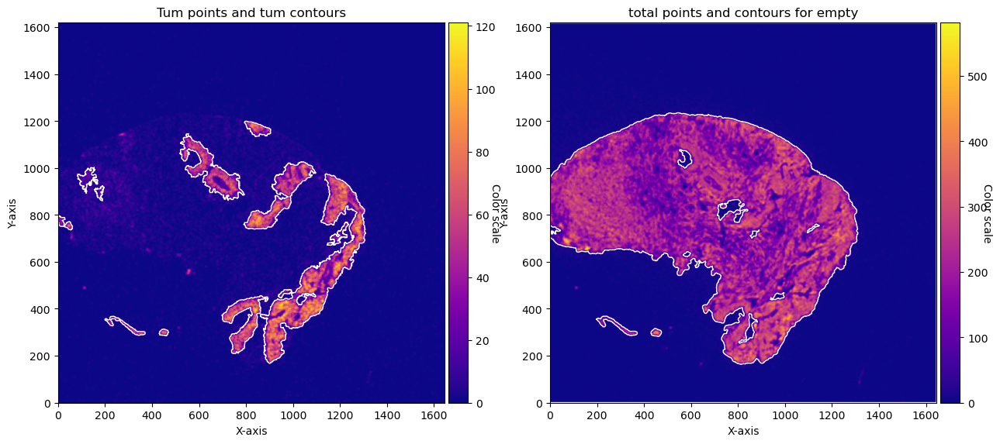

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection31/masks_stromaremaining_tumour_tb_10um_tb_20um.png


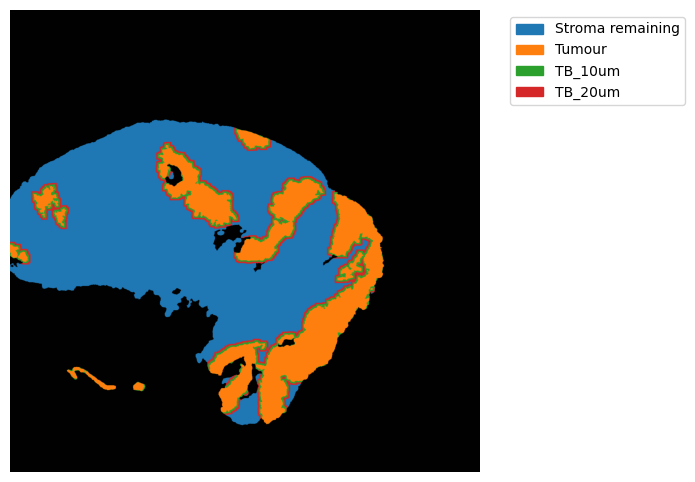

2025-05-29 11:10:40,713 - contour_logger - INFO - The run method took 3.511906147003174 seconds (0.05853176911671956 minutes) to execute
INFO:root:Positive values in array: 1631807
INFO:root:Sum of DataFrame: 1599256
INFO:root:Counts difference: 32551
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection31/TMA1_Selection31_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection31_filtered.csv in 12.291187047958374seconds
Processing Folders:  20%|████████████████████████                                                                                                | 4/20 [01:17<04:45, 17.86s/folder]2025-05-29 11:10:40,799 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection7_filtered.csv


Function 'get_gene_counts' took 3.5125 seconds to execute.
Function 'get_conv_sum' took 0.0774 seconds to execute.
Function 'contours_from_sum' took 1.5849 seconds to execute.
Function 'get_conv_sum' took 0.6837 seconds to execute.
Function 'contours_from_sum' took 7.6964 seconds to execute.


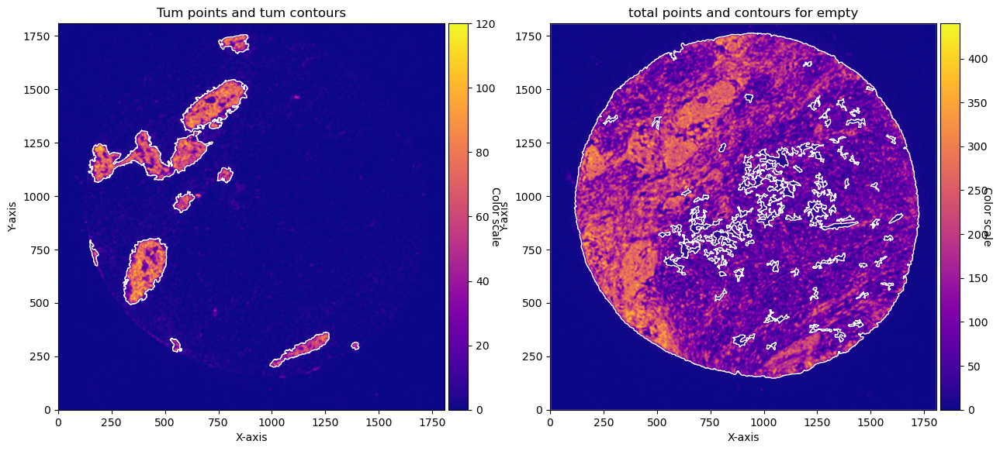

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection7/masks_stromaremaining_tumour_tb_10um_tb_20um.png


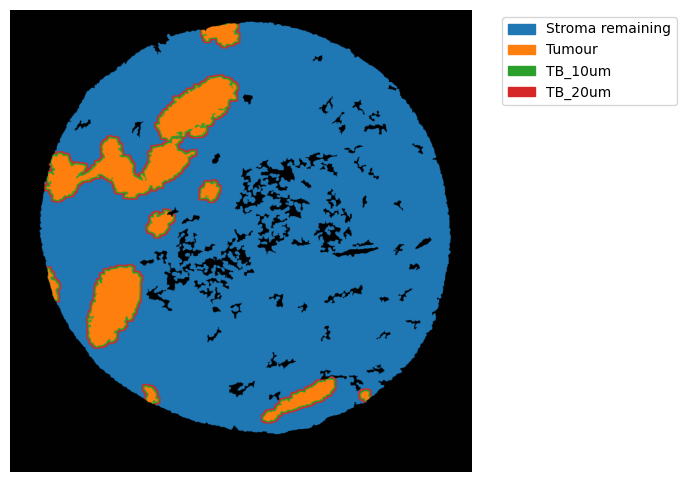

2025-05-29 11:11:02,421 - contour_logger - INFO - The run method took 4.1922266483306885 seconds (0.06987044413884481 minutes) to execute
INFO:root:Positive values in array: 2443378
INFO:root:Sum of DataFrame: 2394224
INFO:root:Counts difference: 49154
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection7/TMA1_Selection7_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection7_filtered.csv in 21.723458766937256seconds
Processing Folders:  25%|██████████████████████████████                                                                                          | 5/20 [01:39<04:48, 19.25s/folder]2025-05-29 11:11:02,523 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection11_filtered.csv


Function 'get_gene_counts' took 4.1927 seconds to execute.
Function 'get_conv_sum' took 0.0792 seconds to execute.
Function 'contours_from_sum' took 7.4929 seconds to execute.
Function 'get_conv_sum' took 0.6048 seconds to execute.
Function 'contours_from_sum' took 1.3367 seconds to execute.


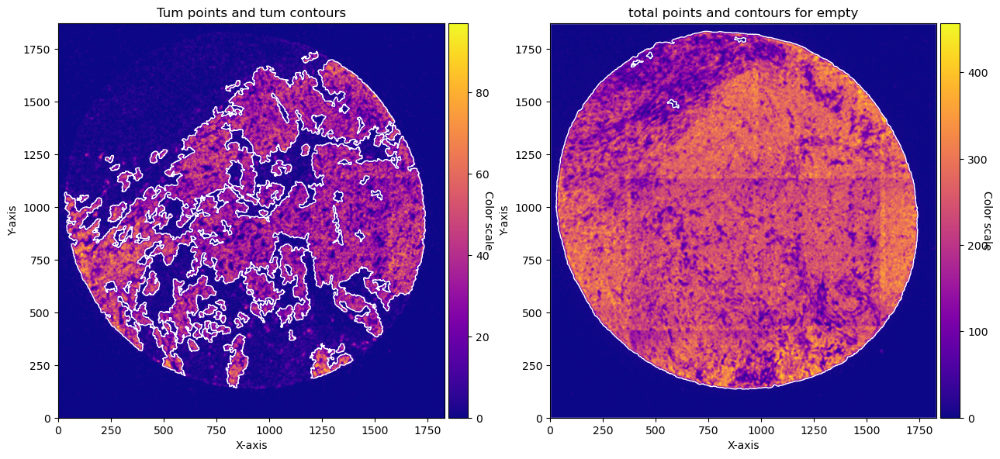

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection11/masks_stromaremaining_tumour_tb_10um_tb_20um.png


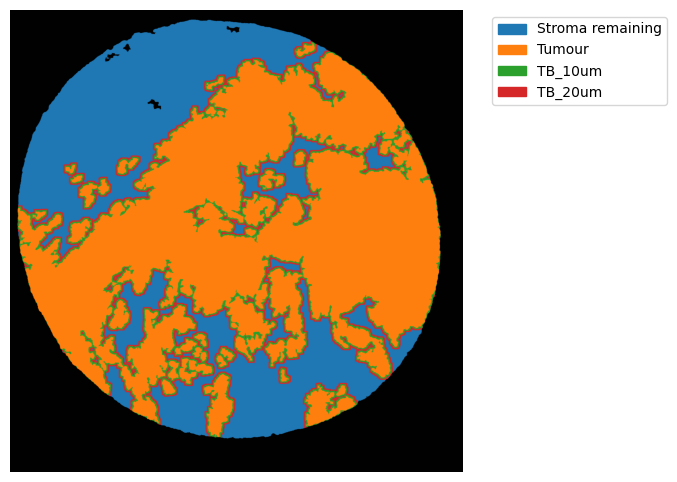

2025-05-29 11:11:27,563 - contour_logger - INFO - The run method took 4.6030964851379395 seconds (0.07671827475229899 minutes) to execute
INFO:root:Positive values in array: 4987743
INFO:root:Sum of DataFrame: 4967942
INFO:root:Counts difference: 19801
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection11/TMA1_Selection11_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection11_filtered.csv in 25.143637895584106seconds
Processing Folders:  30%|████████████████████████████████████                                                                                    | 6/20 [02:04<04:57, 21.25s/folder]2025-05-29 11:11:27,667 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection25_filtered.csv


Function 'get_gene_counts' took 4.6035 seconds to execute.
Function 'get_conv_sum' took 0.0812 seconds to execute.
Function 'contours_from_sum' took 4.9713 seconds to execute.
Function 'get_conv_sum' took 0.6052 seconds to execute.
Function 'contours_from_sum' took 1.1656 seconds to execute.


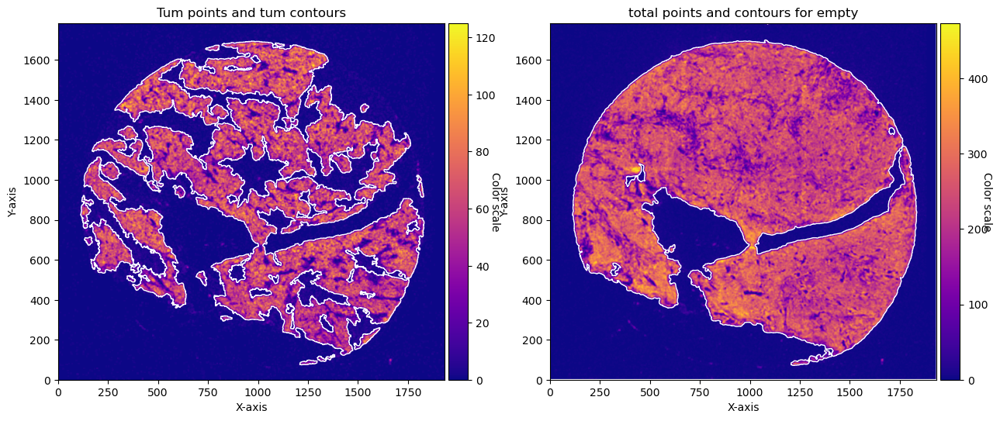

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection25/masks_stromaremaining_tumour_tb_10um_tb_20um.png


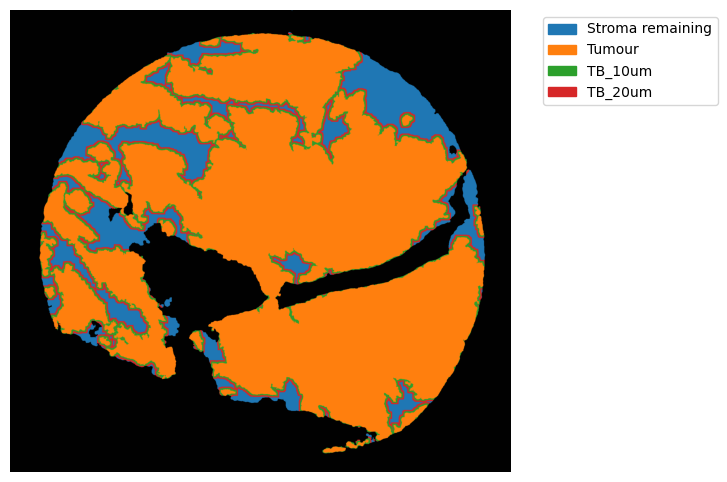

2025-05-29 11:11:49,147 - contour_logger - INFO - The run method took 4.450770139694214 seconds (0.0741795023282369 minutes) to execute
INFO:root:Positive values in array: 4138092
INFO:root:Sum of DataFrame: 4075310
INFO:root:Counts difference: 62782
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection25/TMA1_Selection25_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection25_filtered.csv in 21.58451819419861seconds
Processing Folders:  35%|██████████████████████████████████████████                                                                              | 7/20 [02:26<04:37, 21.36s/folder]2025-05-29 11:11:49,252 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection22_filtered.csv


Function 'get_gene_counts' took 4.4512 seconds to execute.
Function 'get_conv_sum' took 0.0786 seconds to execute.
Function 'contours_from_sum' took 4.2679 seconds to execute.
Function 'get_conv_sum' took 0.5706 seconds to execute.
Function 'contours_from_sum' took 1.5008 seconds to execute.


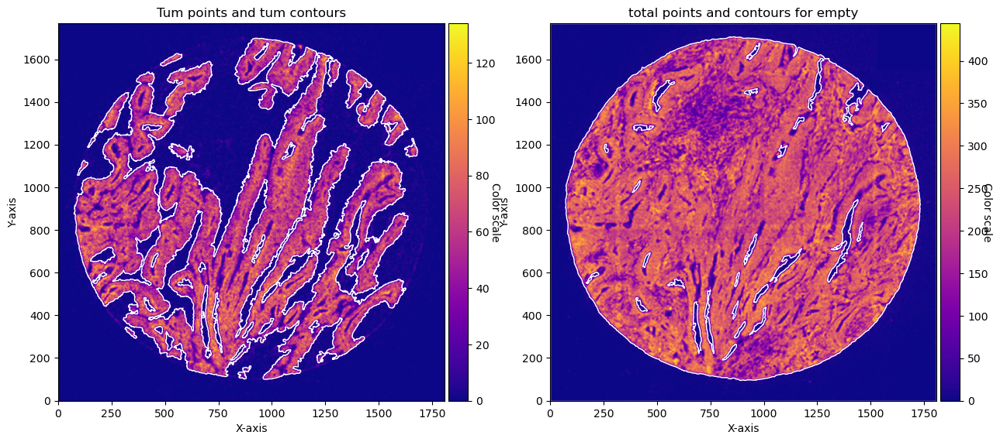

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection22/masks_stromaremaining_tumour_tb_10um_tb_20um.png


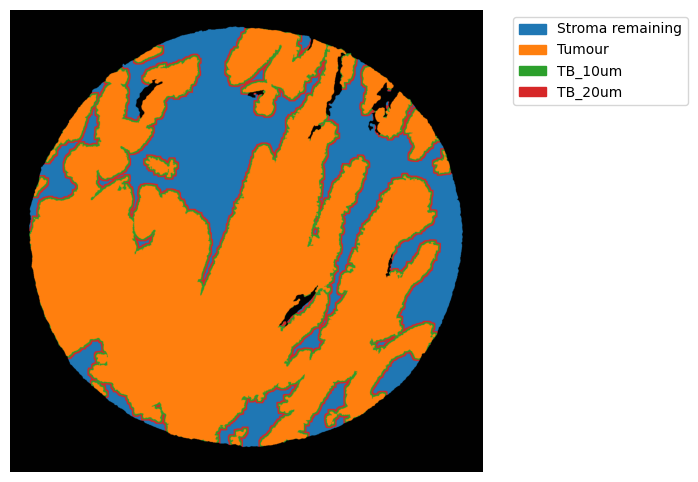

2025-05-29 11:12:09,959 - contour_logger - INFO - The run method took 4.17140007019043 seconds (0.06952333450317383 minutes) to execute
INFO:root:Positive values in array: 4335396
INFO:root:Sum of DataFrame: 4303209
INFO:root:Counts difference: 32187
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection22/TMA1_Selection22_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection22_filtered.csv in 20.80272674560547seconds
Processing Folders:  40%|████████████████████████████████████████████████                                                                        | 8/20 [02:46<04:14, 21.18s/folder]2025-05-29 11:12:10,056 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection30_filtered.csv


Function 'get_gene_counts' took 4.1718 seconds to execute.
Function 'get_conv_sum' took 0.0820 seconds to execute.
Function 'contours_from_sum' took 1.6170 seconds to execute.
Function 'get_conv_sum' took 0.6051 seconds to execute.
Function 'contours_from_sum' took 2.3696 seconds to execute.


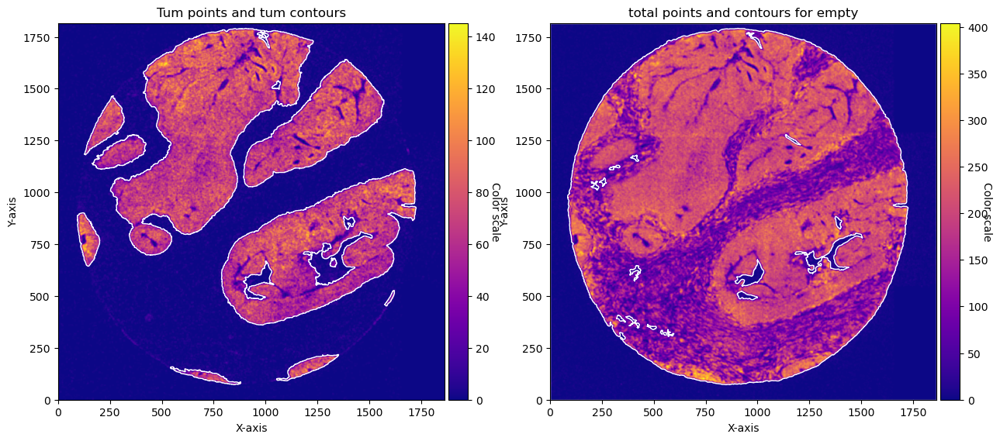

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection30/masks_stromaremaining_tumour_tb_10um_tb_20um.png


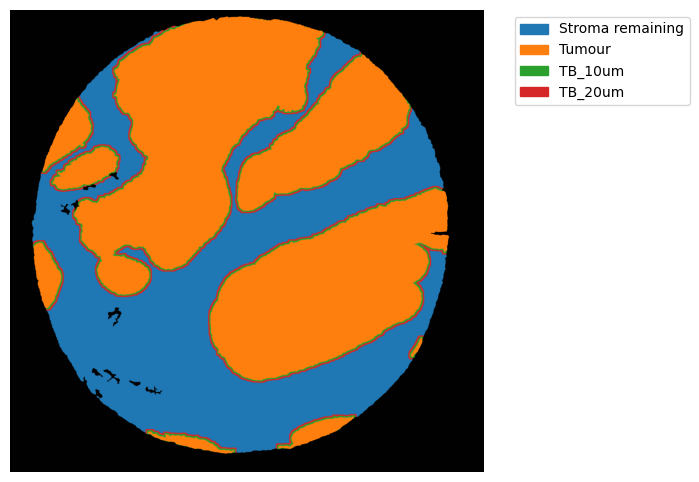

2025-05-29 11:12:28,414 - contour_logger - INFO - The run method took 4.392707347869873 seconds (0.07321178913116455 minutes) to execute
INFO:root:Positive values in array: 3690982
INFO:root:Sum of DataFrame: 3662980
INFO:root:Counts difference: 28002
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection30/TMA1_Selection30_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection30_filtered.csv in 18.46064519882202seconds
Processing Folders:  45%|██████████████████████████████████████████████████████                                                                  | 9/20 [03:05<03:43, 20.33s/folder]2025-05-29 11:12:28,517 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection20_filtered.csv


Function 'get_gene_counts' took 4.3931 seconds to execute.
Function 'get_conv_sum' took 0.0773 seconds to execute.
Function 'contours_from_sum' took 0.5611 seconds to execute.
Function 'get_conv_sum' took 0.5904 seconds to execute.
Function 'contours_from_sum' took 6.4346 seconds to execute.


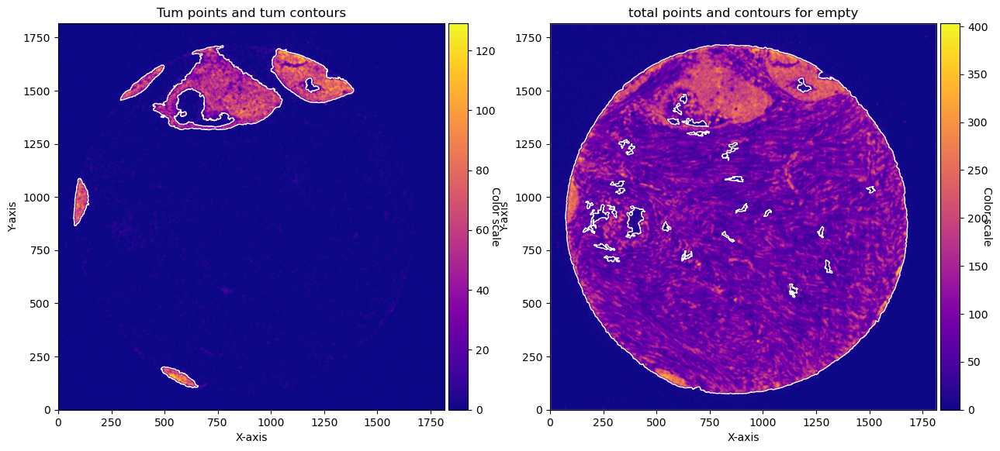

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection20/masks_stromaremaining_tumour_tb_10um_tb_20um.png


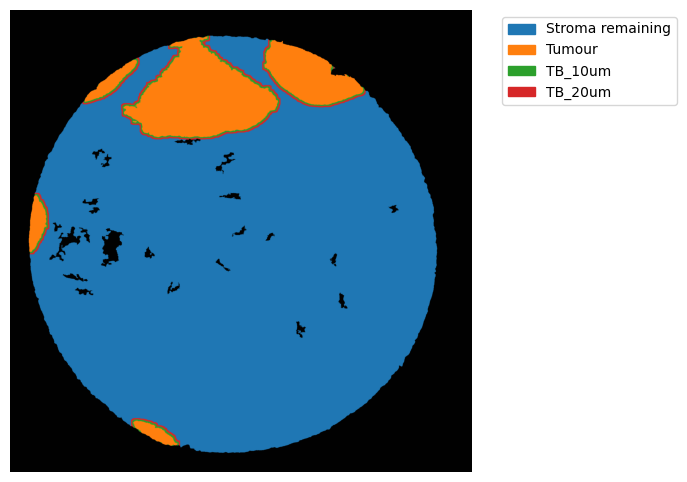

2025-05-29 11:12:46,988 - contour_logger - INFO - The run method took 4.229609727859497 seconds (0.07049349546432496 minutes) to execute
INFO:root:Positive values in array: 2045143
INFO:root:Sum of DataFrame: 2014606
INFO:root:Counts difference: 30537
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection20/TMA1_Selection20_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection20_filtered.csv in 18.57128620147705seconds
Processing Folders:  50%|███████████████████████████████████████████████████████████▌                                                           | 10/20 [03:24<03:17, 19.79s/folder]2025-05-29 11:12:47,089 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection16_filtered.csv


Function 'get_gene_counts' took 4.2300 seconds to execute.
Function 'get_conv_sum' took 0.0615 seconds to execute.
Function 'contours_from_sum' took 1.4361 seconds to execute.
Function 'get_conv_sum' took 0.5138 seconds to execute.
Function 'contours_from_sum' took 1.8823 seconds to execute.


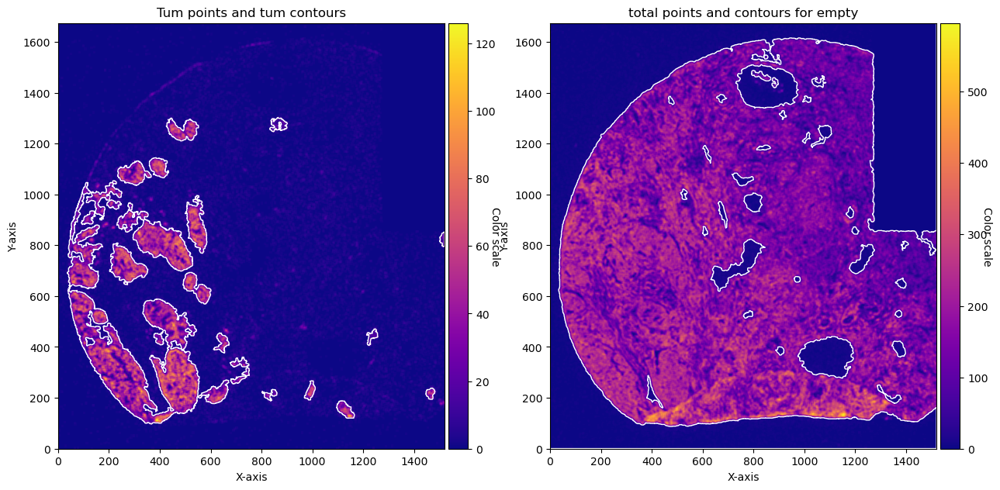

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection16/masks_stromaremaining_tumour_tb_10um_tb_20um.png


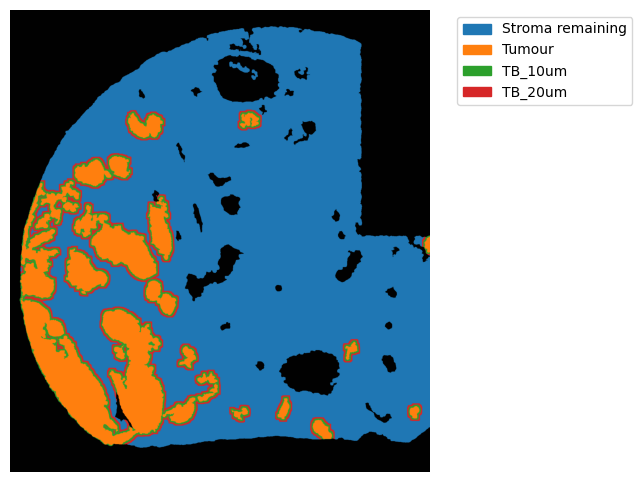

2025-05-29 11:13:01,724 - contour_logger - INFO - The run method took 3.4377245903015137 seconds (0.05729540983835856 minutes) to execute
INFO:root:Positive values in array: 2726521
INFO:root:Sum of DataFrame: 2695262
INFO:root:Counts difference: 31259
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection16/TMA1_Selection16_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection16_filtered.csv in 14.713428258895874seconds
Processing Folders:  55%|█████████████████████████████████████████████████████████████████▍                                                     | 11/20 [03:38<02:44, 18.24s/folder]2025-05-29 11:13:01,803 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection26_filtered.csv


Function 'get_gene_counts' took 3.4381 seconds to execute.
Function 'get_conv_sum' took 0.0605 seconds to execute.
Function 'contours_from_sum' took 2.4795 seconds to execute.
Function 'get_conv_sum' took 0.4984 seconds to execute.
Function 'contours_from_sum' took 1.2916 seconds to execute.


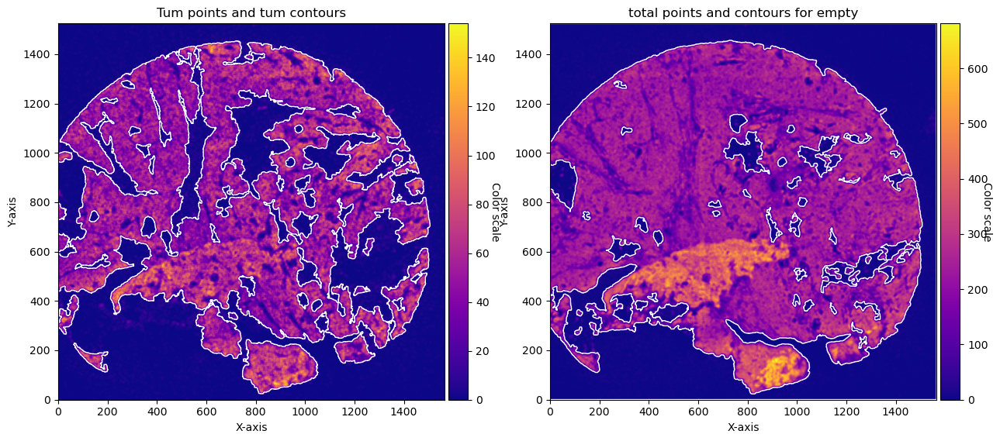

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection26/masks_stromaremaining_tumour_tb_10um_tb_20um.png


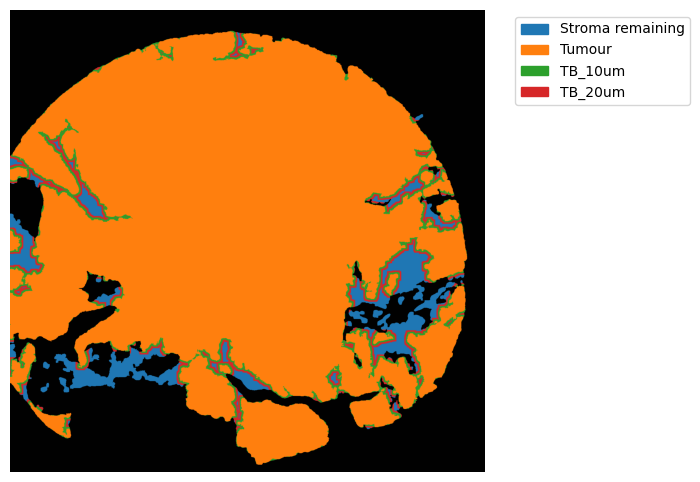

2025-05-29 11:13:16,553 - contour_logger - INFO - The run method took 3.2595713138580322 seconds (0.054326188564300534 minutes) to execute
INFO:root:Positive values in array: 3332964
INFO:root:Sum of DataFrame: 3292908
INFO:root:Counts difference: 40056
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection26/TMA1_Selection26_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection26_filtered.csv in 14.826833963394165seconds
Processing Folders:  60%|███████████████████████████████████████████████████████████████████████▍                                               | 12/20 [03:53<02:17, 17.20s/folder]2025-05-29 11:13:16,630 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection8_filtered.csv


Function 'get_gene_counts' took 3.2600 seconds to execute.
Function 'get_conv_sum' took 0.0684 seconds to execute.
Function 'contours_from_sum' took 0.6829 seconds to execute.
Function 'get_conv_sum' took 0.6084 seconds to execute.
Function 'contours_from_sum' took 4.1081 seconds to execute.


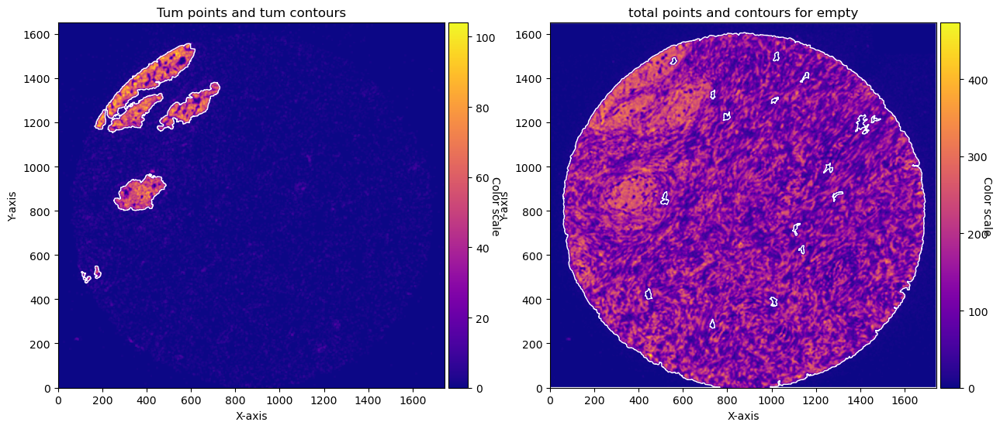

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection8/masks_stromaremaining_tumour_tb_10um_tb_20um.png


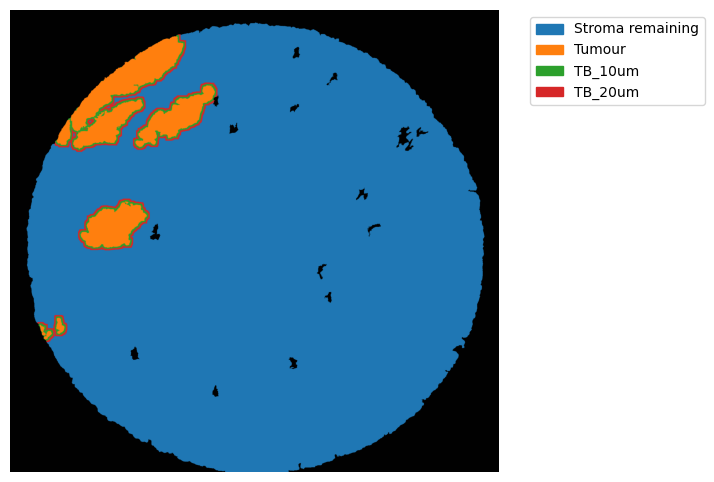

2025-05-29 11:13:33,674 - contour_logger - INFO - The run method took 3.631885290145874 seconds (0.06053142150243123 minutes) to execute
INFO:root:Positive values in array: 2829828
INFO:root:Sum of DataFrame: 2804164
INFO:root:Counts difference: 25664
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection8/TMA1_Selection8_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection8_filtered.csv in 17.13418745994568seconds
Processing Folders:  65%|█████████████████████████████████████████████████████████████████████████████▎                                         | 13/20 [04:10<02:00, 17.18s/folder]2025-05-29 11:13:33,765 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection29_filtered.csv


Function 'get_gene_counts' took 3.6323 seconds to execute.
Function 'get_conv_sum' took 0.0645 seconds to execute.
Function 'contours_from_sum' took 5.4727 seconds to execute.
Function 'get_conv_sum' took 0.4917 seconds to execute.
Function 'contours_from_sum' took 4.6350 seconds to execute.


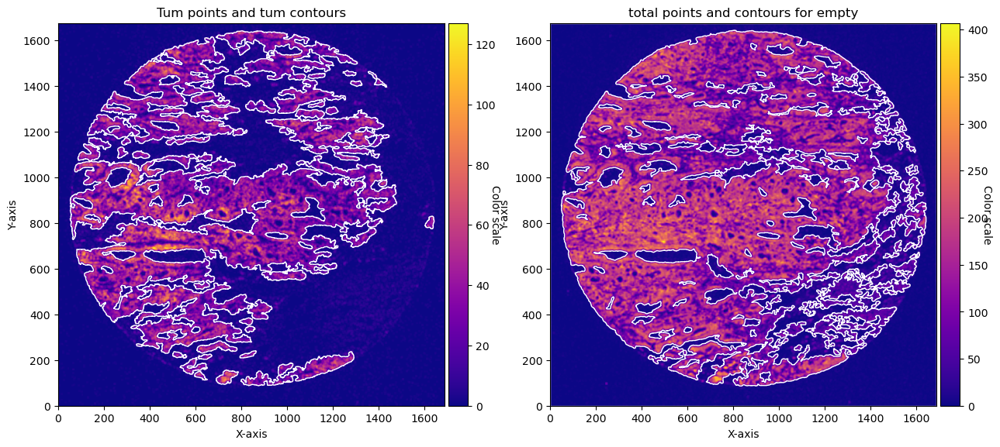

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection29/masks_stromaremaining_tumour_tb_10um_tb_20um.png


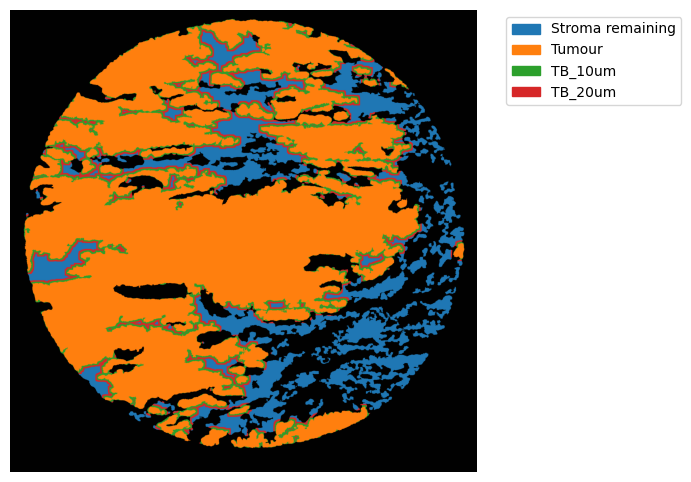

2025-05-29 11:13:54,923 - contour_logger - INFO - The run method took 3.6715550422668457 seconds (0.06119258403778076 minutes) to execute
INFO:root:Positive values in array: 2048917
INFO:root:Sum of DataFrame: 1959166
INFO:root:Counts difference: 89751
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection29/TMA1_Selection29_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection29_filtered.csv in 21.243280172348022seconds
Processing Folders:  70%|███████████████████████████████████████████████████████████████████████████████████▎                                   | 14/20 [04:31<01:50, 18.41s/folder]2025-05-29 11:13:55,009 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection13_filtered.csv


Function 'get_gene_counts' took 3.6720 seconds to execute.
Function 'get_conv_sum' took 0.0817 seconds to execute.
Function 'contours_from_sum' took 1.9226 seconds to execute.
Function 'get_conv_sum' took 0.6944 seconds to execute.
Function 'contours_from_sum' took 1.2977 seconds to execute.


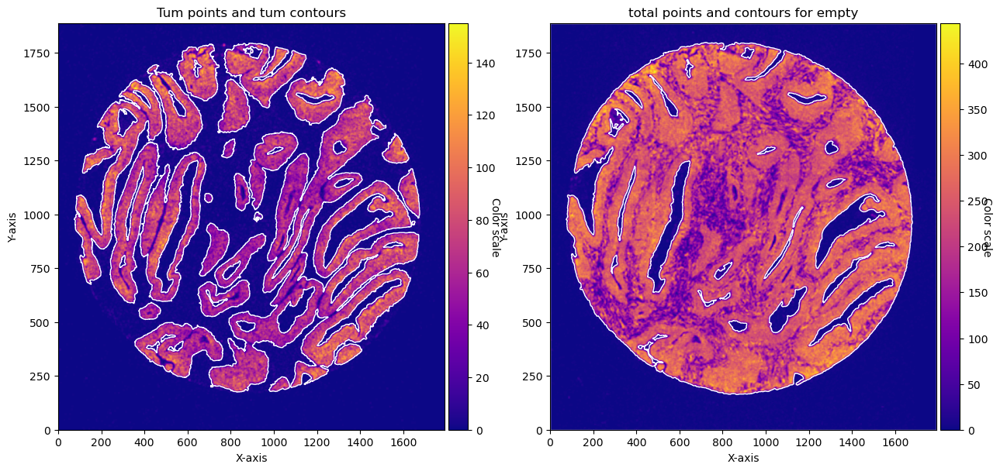

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection13/masks_stromaremaining_tumour_tb_10um_tb_20um.png


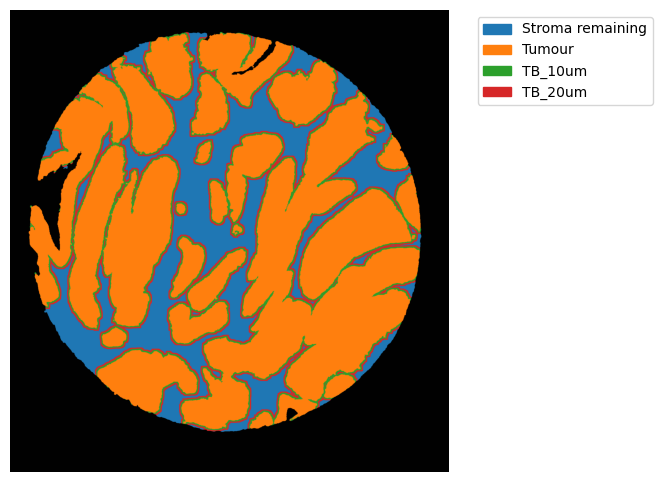

2025-05-29 11:14:13,056 - contour_logger - INFO - The run method took 4.5840394496917725 seconds (0.07640065749486287 minutes) to execute
INFO:root:Positive values in array: 4016057
INFO:root:Sum of DataFrame: 3986538
INFO:root:Counts difference: 29519
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection13/TMA1_Selection13_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection13_filtered.csv in 18.151776790618896seconds
Processing Folders:  75%|█████████████████████████████████████████████████████████████████████████████████████████▎                             | 15/20 [04:50<01:31, 18.33s/folder]2025-05-29 11:14:13,162 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection12_filtered.csv


Function 'get_gene_counts' took 4.5844 seconds to execute.
Function 'get_conv_sum' took 0.0771 seconds to execute.
Function 'contours_from_sum' took 3.8304 seconds to execute.
Function 'get_conv_sum' took 0.5460 seconds to execute.
Function 'contours_from_sum' took 1.6191 seconds to execute.


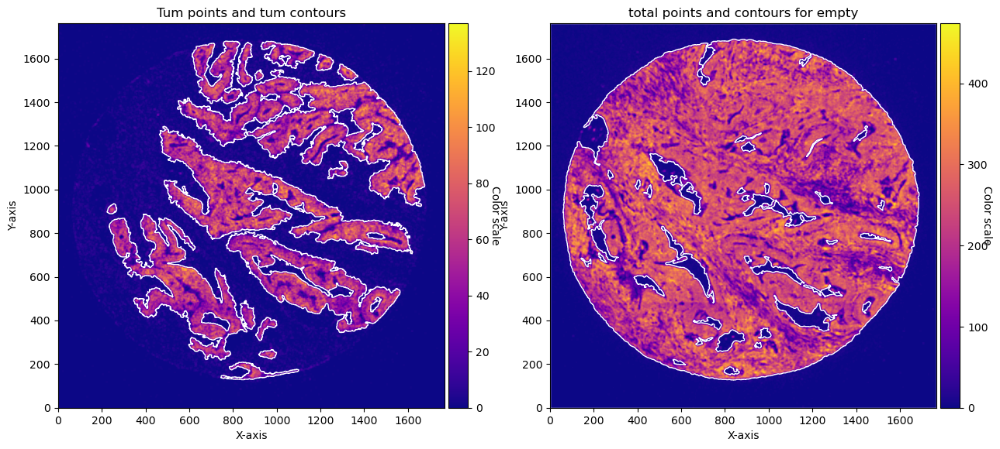

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection12/masks_stromaremaining_tumour_tb_10um_tb_20um.png


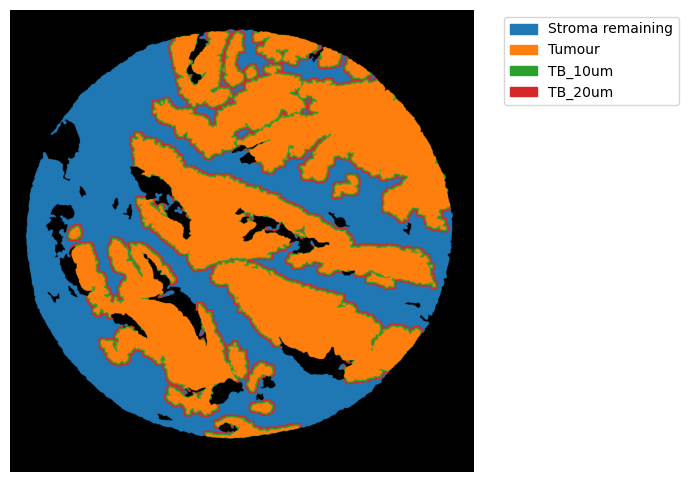

2025-05-29 11:14:32,875 - contour_logger - INFO - The run method took 4.163227796554565 seconds (0.06938712994257609 minutes) to execute
INFO:root:Positive values in array: 3963475
INFO:root:Sum of DataFrame: 3925067
INFO:root:Counts difference: 38408
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection12/TMA1_Selection12_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection12_filtered.csv in 19.808773040771484seconds
Processing Folders:  80%|███████████████████████████████████████████████████████████████████████████████████████████████▏                       | 16/20 [05:09<01:15, 18.78s/folder]2025-05-29 11:14:32,971 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection28_filtered.csv


Function 'get_gene_counts' took 4.1638 seconds to execute.
Function 'get_conv_sum' took 0.0790 seconds to execute.
Function 'contours_from_sum' took 2.6208 seconds to execute.
Function 'get_conv_sum' took 0.5896 seconds to execute.
Function 'contours_from_sum' took 5.2105 seconds to execute.


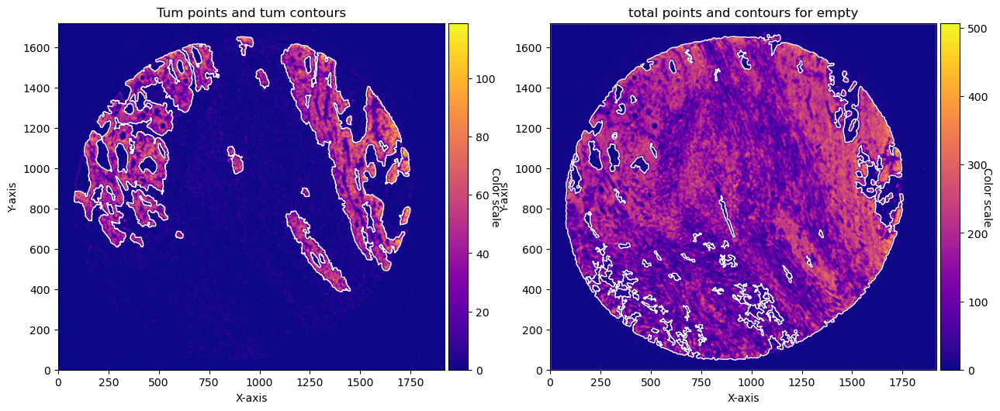

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection28/masks_stromaremaining_tumour_tb_10um_tb_20um.png


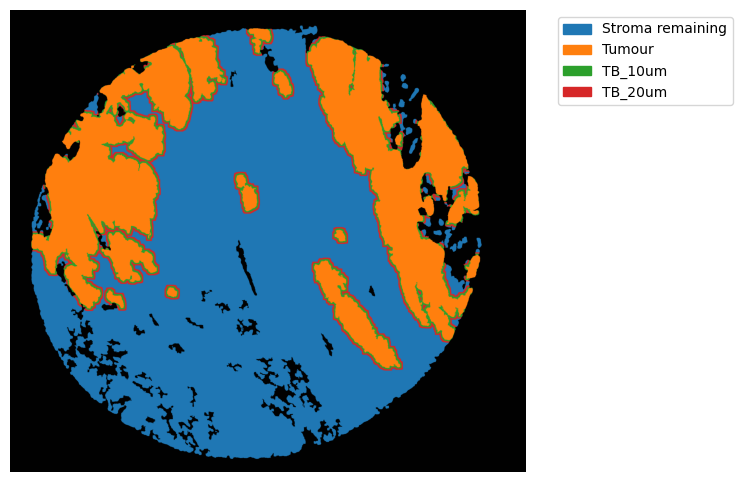

2025-05-29 11:14:53,917 - contour_logger - INFO - The run method took 4.228931427001953 seconds (0.07048219045003255 minutes) to execute
INFO:root:Positive values in array: 2854010
INFO:root:Sum of DataFrame: 2799385
INFO:root:Counts difference: 54625
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection28/TMA1_Selection28_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection28_filtered.csv in 21.04482865333557seconds
Processing Folders:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 17/20 [05:30<00:58, 19.46s/folder]2025-05-29 11:14:54,017 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection34_filtered.csv


Function 'get_gene_counts' took 4.2293 seconds to execute.
Function 'get_conv_sum' took 0.0869 seconds to execute.
Function 'contours_from_sum' took 2.0629 seconds to execute.
Function 'get_conv_sum' took 0.7648 seconds to execute.
Function 'contours_from_sum' took 3.2979 seconds to execute.


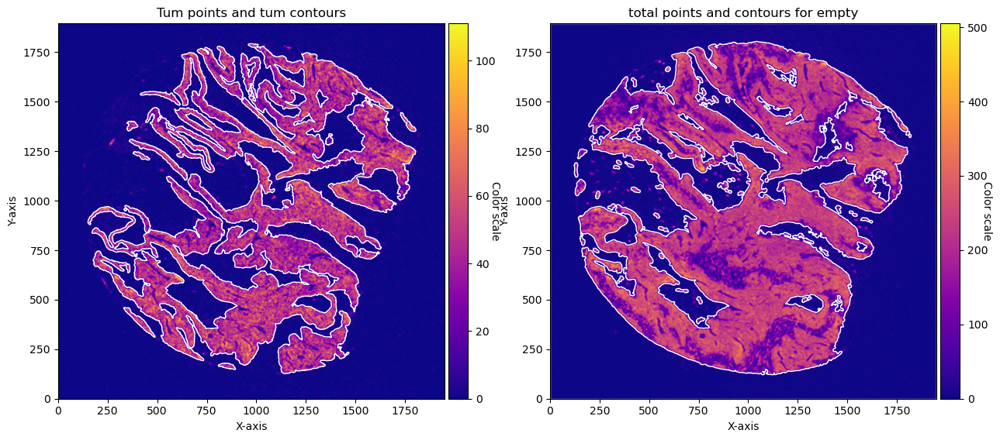

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection34/masks_stromaremaining_tumour_tb_10um_tb_20um.png


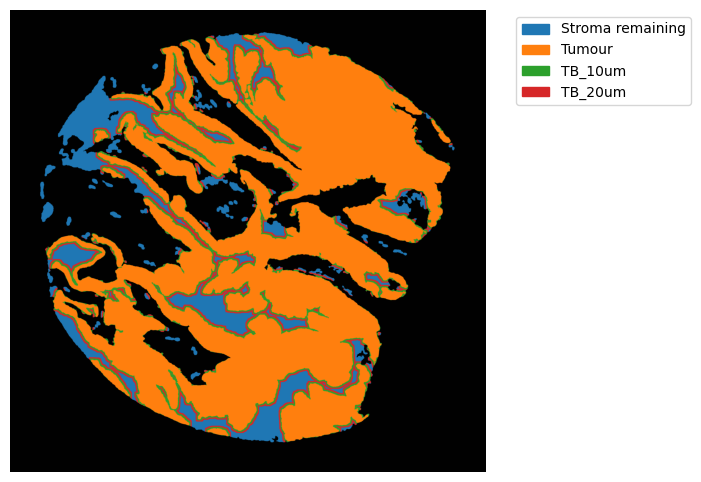

2025-05-29 11:15:13,827 - contour_logger - INFO - The run method took 4.962273359298706 seconds (0.08270455598831176 minutes) to execute
INFO:root:Positive values in array: 3104683
INFO:root:Sum of DataFrame: 3005727
INFO:root:Counts difference: 98956
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection34/TMA1_Selection34_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection34_filtered.csv in 19.924437046051025seconds
Processing Folders:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████            | 18/20 [05:50<00:39, 19.60s/folder]2025-05-29 11:15:13,941 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection9_filtered.csv


Function 'get_gene_counts' took 4.9627 seconds to execute.


/tmp/ipykernel_3355801/4037327334.py:24: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  df_total = pd.read_csv(file_csv)


Function 'get_conv_sum' took 0.0753 seconds to execute.
Function 'contours_from_sum' took 5.8595 seconds to execute.
Function 'get_conv_sum' took 0.5336 seconds to execute.
Function 'contours_from_sum' took 3.3611 seconds to execute.


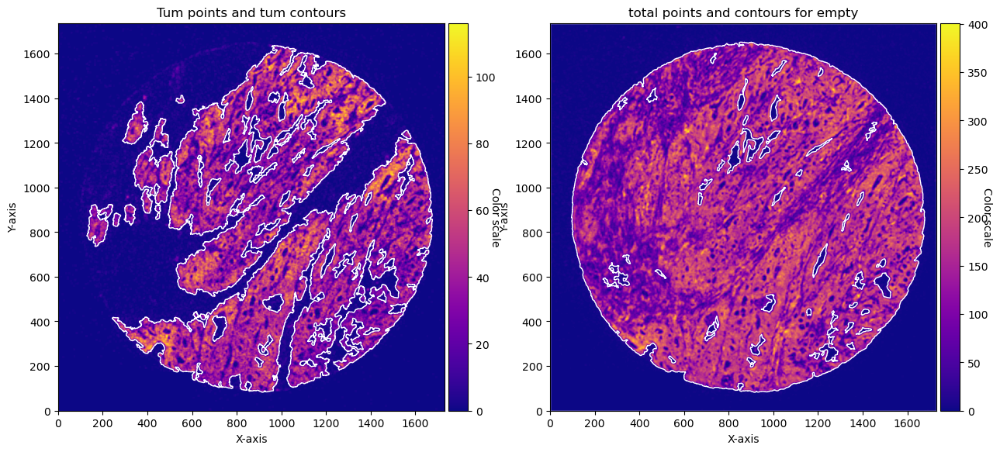

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection9/masks_stromaremaining_tumour_tb_10um_tb_20um.png


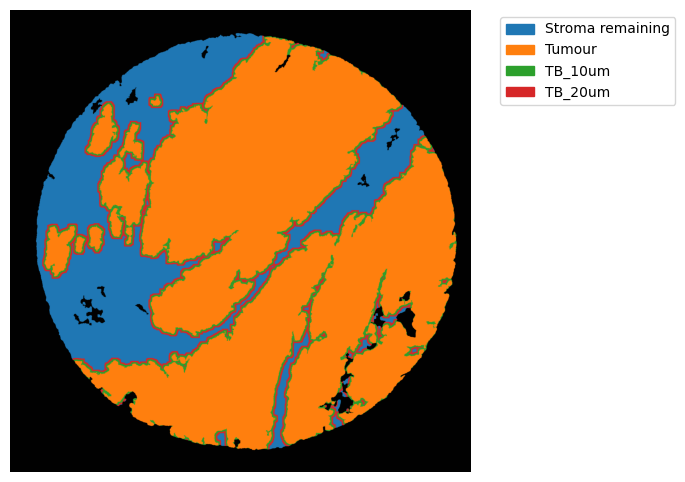

2025-05-29 11:15:35,380 - contour_logger - INFO - The run method took 3.8842177391052246 seconds (0.06473696231842041 minutes) to execute
INFO:root:Positive values in array: 2698912
INFO:root:Sum of DataFrame: 2677122
INFO:root:Counts difference: 21790
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection9/TMA1_Selection9_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection9_filtered.csv in 21.532012939453125seconds
Processing Folders:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 19/20 [06:12<00:20, 20.18s/folder]2025-05-29 11:15:35,474 - contour_logger - INFO - Processing folder ../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection19_filtered.csv


Function 'get_gene_counts' took 3.8846 seconds to execute.
Function 'get_conv_sum' took 0.0666 seconds to execute.
Function 'contours_from_sum' took 6.2214 seconds to execute.
Function 'get_conv_sum' took 0.5049 seconds to execute.
Function 'contours_from_sum' took 3.7265 seconds to execute.


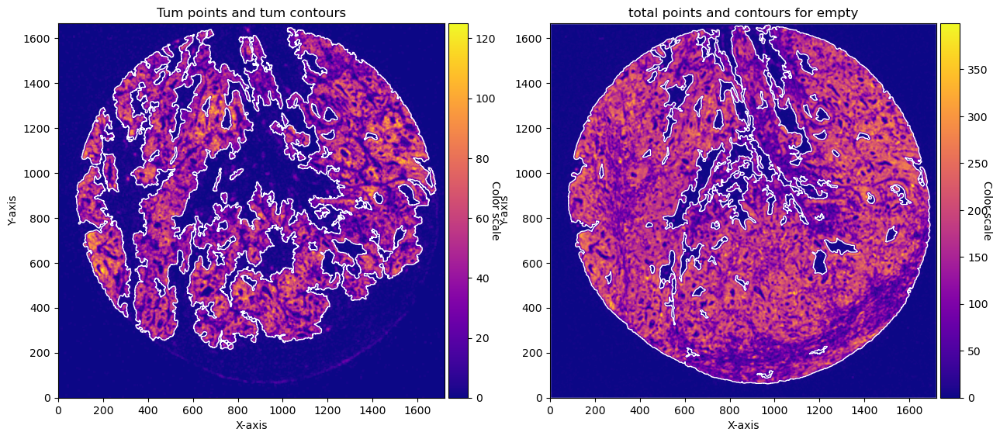

INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Filtering border mask by area: 3000
INFO:GRIDGEN.src.masks:Plot saved at results/tb_xenium_gr/TMA1_Selection19/masks_stromaremaining_tumour_tb_10um_tb_20um.png


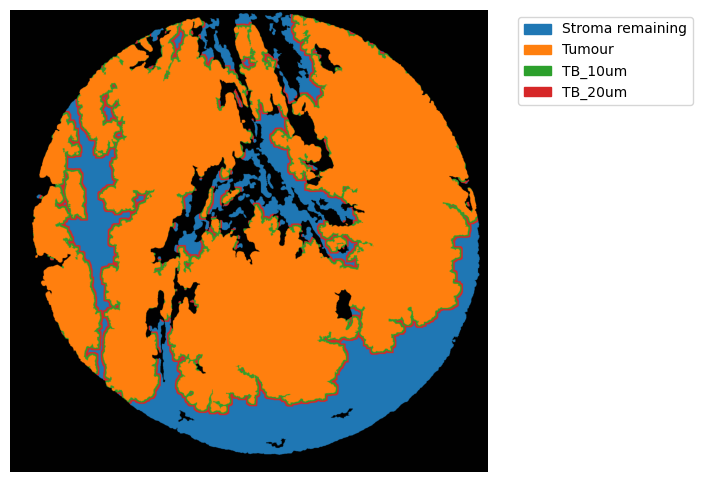

2025-05-29 11:15:57,235 - contour_logger - INFO - The run method took 3.7318105697631836 seconds (0.062196842829386395 minutes) to execute
INFO:root:Positive values in array: 2582518
INFO:root:Sum of DataFrame: 2543422
INFO:root:Counts difference: 39096
INFO:root:Dataframe saved to results/tb_xenium_gr/TMA1_Selection19/TMA1_Selection19_tb.csv
INFO:root:process../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection19_filtered.csv in 21.852389335632324seconds
Processing Folders: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [06:34<00:00, 19.71s/folder]
INFO:root:full analysis in -394.2569773197174seconds


Function 'get_gene_counts' took 3.7322 seconds to execute.


In [12]:
start_time = time.time()
save_path_ = 'results/tb_xenium_gr/'
if not os.path.exists(save_path_):
    os.makedirs(save_path_)

logger = logging.getLogger('contour_logger')
handler = logging.FileHandler(f'{save_path_}/log_file.log')  # Change this to your desired log file path
formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
handler.setFormatter(formatter)
logger.addHandler(handler)
logger.setLevel(logging.INFO)
logger.propagate = False

# TUM / STROMA + TM BORDER
for file_csv in tqdm(files, desc="Processing Folders", unit="folder"):
    start_time_lap = time.time()
    logger.info(f'Processing folder {file_csv}')
    base_name = os.path.basename(file_csv)
    file_name = "_".join(base_name.split("_")[:2])
    save_path = os.path.join(save_path_, file_name)
    if not os.path.exists(save_path):
        os.makedirs(save_path)

    df_total = pd.read_csv(file_csv)
    df_total = df_total[['x_location', 'y_location', 'feature_name']]
    df_total = df_total.rename(columns={'feature_name': 'target'})
    df_total = df_total[~df_total['target'].str.contains('System|egative')]
    df_total['X'] = df_total['x_location'] - min(df_total['x_location'])
    df_total['Y'] = df_total['y_location'] - min(df_total['y_location'])
    
    n_genes = len(df_total['target'].unique())
    height = int(max(df_total['X'])) + 1
    width = int(max(df_total['Y'])) + 1
        
    # define arrays
    target_dict_total = {target: index for index, target in enumerate(df_total['target'].unique())}
    array_total = ga.transform_df_to_array(df = df_total, target_dict=target_dict_total, array_shape = (height, width,len(target_dict_total))).astype(np.int8)
    df_subset_tum, array_subset_tum, target_indices_subset_tum = ga.get_subset_arrays(df_total, array_total,target_dict_total,
                                                                         target_list=target_tum, target_col = 'target')
        
    # obtain contours 
    CTum = contours.ConvolutionContours(array_subset_tum, contour_name='tum')
    CTum.get_conv_sum(kernel_size=kernel_size_tum, kernel_shape='square')
    CTum.contours_from_sum(density_threshold = density_th_tum,
                           min_area_threshold = min_area_th_tum , directionality = 'higher')

    CEmpty = contours.ConvolutionContours(array_total, contour_name='empty')
    CEmpty.get_conv_sum(kernel_size=kernel_size_empty, kernel_shape='square')
    CEmpty.contours_from_sum(density_threshold = density_th_empty,
                           min_area_threshold = min_area_th_empty, directionality = 'lower') # attention that directionality is lower here 
    
    # PLOTs
    
#     fig, axs = plt.subplots(1, 2, figsize=(30, 15))
#     CTum.plot_contours_scatter(path=None, show=False, s=0.05, alpha=0.5, linewidth=1,
#                                c_points= 'blue',c_contours= 'red', ax=axs[0])
#     axs[0].set_title('Tum points and tum contours')  
    
    
#     CEmpty.plot_contours_scatter(path=None, show=False, s=0.05, alpha=0.5, linewidth=1,
#                                c_points= 'blue',c_contours= 'red', ax=axs[1])
#     axs[0].set_title('total points and contours for empty')  
#     plt.subplots_adjust(wspace=0.02)  # Adjust to your preference
    
#     plt.show()
       
    
    fig, axs = plt.subplots(1, 2, figsize=(15, 10))
    
    CTum.plot_conv_sum(cmap='plasma', c_countour='white', ax=axs[0])
    axs[0].set_title('Tum points and tum contours')
    
    CEmpty.plot_conv_sum(cmap='plasma', c_countour='white', ax=axs[1])
    axs[1].set_title('total points and contours for empty')
    
    plt.show()
    
    
    
    #### obtain masks
    GM = masks.GetMasks(image_shape = (height, width))
    
    mask_empty = GM.create_mask(CEmpty.contours)
    mask_tum = GM.create_mask(CTum.contours)
    mask_tum = GM.fill_holes(mask_tum)
    mask_stroma = GM.subtract_masks(np.ones((height, width), dtype=np.uint8), mask_tum, mask_empty)          
    mask_stroma = GM.filter_mask_by_area(mask_stroma, min_area=700)
    GM.mask_S = mask_stroma
    GM.mask_T = mask_tum

    #### tumour border analysis
    TA = masks.TumBorderAnalysis(GM)
    TA.get_mask_tumour_border(expansions_pixels=[10, 20], filter_area=3000)
    mask_stroma_tborder = TA.mask_S_tborder
    mask_tumour_tborder = TA.mask_T_tborder  # will be the same as T overall
    (mask_TB_10px, mask_TB_20px) = TA.mask_TB_tborders

    mask_dict = {
        'mask_stroma_tborder': mask_stroma_tborder,
        'mask_tumour_tborder': mask_tumour_tborder,
        'mask_TB_10px': mask_TB_10px,
        'mask_TB_20px': mask_TB_20px,
    }

    GM.plot_masks(masks=[TA.mask_S_tborder, TA.mask_T_tborder, mask_TB_10px, mask_TB_20px],
                  mask_names=['Stroma remaining', 'Tumour', 'TB_10um','TB_20um',
                              ],
                  background_color=(1, 1, 1), mask_colors=None, path=save_path, show=True, ax=None,
                 figsize=(8, 6))

    # Extract the information
    masks_analysis_tb = [
        {'mask': TA.mask_S_tborder, 'mask_name': 'Stroma', 'per_object': False, 'level_hierarchy': None},
        {'mask': TA.mask_T_tborder, 'mask_name': 'Cancer', 'per_object': False, 'level_hierarchy': None},
        {'mask': mask_TB_10px, 'mask_name': 'TB_10um', 'per_object': False, 'level_hierarchy': None},
        {'mask': mask_TB_20px, 'mask_name': 'TB_20um', 'per_object': False, 'level_hierarchy': None},

    ]

    GP = GetMasksProperties(masks_dict = masks_analysis_tb,array_counts = array_total,
                            target_dict = target_dict_total,
                            logger = logger, image_shape = (height, width), save_path = None)
    
    final_result = GP.get_gene_counts()
    GP.check_counts()
    GP.save_df(os.path.join(save_path + f'/{file_name}_tb.csv'))

    # Calculate the duration
    duration = time.time() - start_time_lap
    logging.info(f'process{file_csv} in {duration}seconds')


# Record the end time
end_time = time.time()

# Calculate the duration
duration = start_time - time.time()
logging.info(f'full analysis in {duration}seconds')

# Analysis of the results from Cancer Stroma interface

To be noted that each total mask per sample is one object. This is, only one cancer object, one stroma object, one 10 um interface and one 20 um interface per sample. 

Grab information stored in csv

In [16]:
save_path_ = 'results/tb_xenium_gr/'

dfs = []
for file in files: 
    base_name = os.path.basename(file)
    selection_name = "_".join(base_name.split("_")[:2])
    df = pd.read_csv(f'{save_path_}/{selection_name}/{selection_name}_tb.csv')
    df['selection'] = selection_name
    dfs.append(df)


full_df = pd.concat(dfs, ignore_index=True)
full_df.head()

Loading ITables v2.4.0 from the init_notebook_mode cell... (need help?)


Transform into adata bject

In [18]:
obs_columns = ['area', 'perimeter', 'centroid', 'min_x', 'min_y', 'max_x', 'max_y', 'vertices', 
               'BoundingBox', 'mask_name', 'per_object', 'selection', 'object_id']
counts_columns = full_df.columns.difference(obs_columns)
counts = full_df[counts_columns]

obs = full_df[obs_columns]


adata = ad.AnnData(counts)
adata.obs = obs
adata.layers["counts"] = adata.X.copy()

adata.obs = adata.obs.merge(metadata, left_on='selection', right_on='name', how='left')

#combine TB of 10 and 20in an unque TB
combined_replacements = {
    'TB_10um': 'Cancer_interface',
    'TB_20um': 'Cancer_interface'
}
obs['mask_name_combined'] = obs['mask_name'].replace(combined_replacements).astype('category')
adata.obs['mask_name_combined'] = obs['mask_name_combined']

print('number of cores: ', len(adata.obs['name'].unique()))
print('number of cores: ', len(adata.obs['name'].unique()))
adata.obs.head()

number of cores:  20
number of cores:  20


/home/martinha/miniconda3/envs/GRIDGEN/lib/python3.11/site-packages/anndata/utils.py:311: UserWarning: X converted to numpy array with dtype float64
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")
/home/martinha/miniconda3/envs/GRIDGEN/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/tmp/ipykernel_3355801/1311220816.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  obs['mask_name_combined'] = obs['mask_name'].replace(combined_replacements).astype('category')


Loading ITables v2.4.0 from the init_notebook_mode cell... (need help?)


Areas of the mask

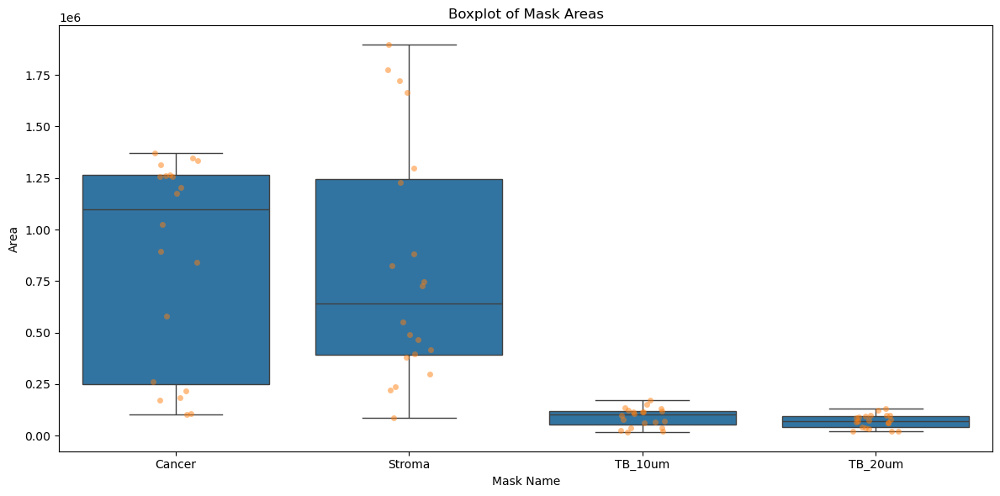

In [19]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='mask_name', y='area', data=adata.obs, showfliers=False)

# Overlay the points
sns.stripplot(x='mask_name', y='area', data=adata.obs, alpha=0.5)

plt.title('Boxplot of Mask Areas')
plt.xlabel('Mask Name')
plt.ylabel('Area')
plt.tight_layout()
plt.show()

Normalization

We will normalize the values, as it was single cell data

Elbow at:  15


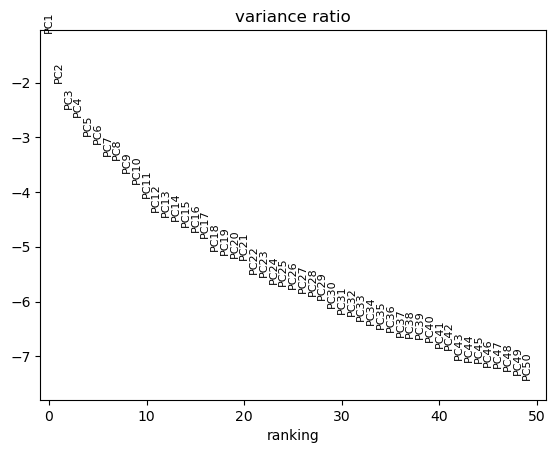

... storing 'mask_name' as categorical
... storing 'selection' as categorical
... storing 'XENIUM_TMA' as categorical
... storing 'Selection' as categorical
... storing 'Hes' as categorical
... storing 'TMA' as categorical
... storing 'COSMX selection' as categorical
... storing 'Case' as categorical
... storing 'Block' as categorical
... storing 'Unnamed: 8' as categorical
... storing 'MMR' as categorical
... storing 'HLA' as categorical
... storing 'B2M abcam' as categorical
... storing 'IHC group' as categorical
... storing 'B2M gene defect' as categorical
... storing 'Final group' as categorical
... storing 'name' as categorical


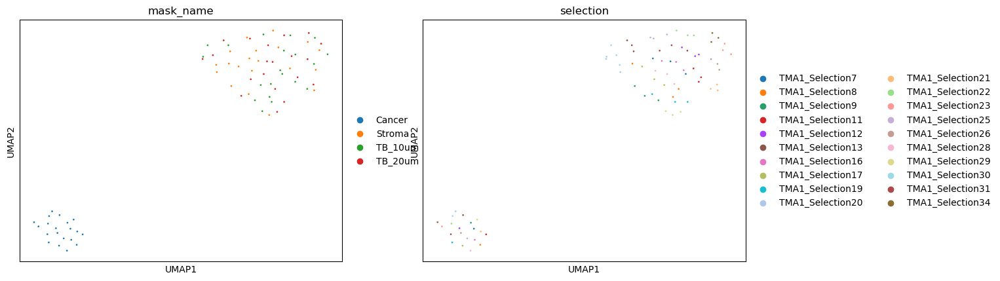

In [20]:
# Normalize the counts in the 'X' matrix
adata.X = np.nan_to_num(adata.X / adata.obs['area'].values[:, None])*100
# sc.pp.scale(adata)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

sc.tl.pca(adata)
pct = adata.uns['pca']['variance_ratio'] / sum(adata.uns['pca']['variance_ratio']) * 100
cumu = np.cumsum(pct)
# Point 1.
co1 = list(np.where(np.logical_and(cumu > 90, pct < 5))[0])[0]
# Point 2.
x = list(np.where(pct[0:len(pct)-1] - pct[1:len(pct)] > 0.1)[0])
x.sort(reverse=True)
co2 = x[0]+1
# Elbow:
elbow = min(co1, co2) + 1 # Without the +1, it gives the index and not the PC number
                          # (indices in python start with 0, unlike R that start with 1)
print('Elbow at: ', elbow)

sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)

sc.pp.neighbors(adata, n_neighbors=20) #, n_pcs=elbow)

sc.tl.umap(adata) 

sc.pl.umap(
    adata,
    color= ["mask_name", "selection"],
    size=15,
)

Cancer masks are clearly distinct from Stroma masks, which it is to be expected. From the UMAP there is no clear separation between Stroma and interface masks.

***Differential gene expression***

Stroma vs TB vs Tumour

Stroma vs TB

TB vs tumour remaining

In [21]:
# function for rank genes and derive dfs
def rank_subgroup_results_dotplot(groupcl, column_name = 'Final group', save_fig=None):
    # groupcl.uns['log1p']['base'] = None
    sc.tl.rank_genes_groups(groupcl,column_name, method='wilcoxon', pts=True)
    sc.tl.filter_rank_genes_groups(groupcl, groupby=column_name, min_fold_change=1)

    # Extract the results
    result = groupcl.uns['rank_genes_groups']
    groups = result['names'].dtype.names

    # Create a DataFrame to store the results
    result_df = pd.DataFrame()
    for group in groups:
        group_df = pd.DataFrame({
            'gene': result['names'][group],
            'logfoldchanges': result['logfoldchanges'][group],
            'pvals': result['pvals'][group],
            'pvals_adj': result['pvals_adj'][group],
            'scores': result['scores'][group]
        })
        group_df['mask'] = group
        result_df = pd.concat([result_df, group_df], ignore_index=True)

    if save_fig:
        sc.pl.rank_genes_groups_dotplot(groupcl, groupby=column_name, standard_scale="var", n_genes=15,save='dotplot.png')
    else:
        sc.pl.rank_genes_groups_dotplot(groupcl, groupby=column_name, standard_scale="var", n_genes=15)

    return result_df

Loading ITables v2.4.0 from the init_notebook_mode cell... (need help?)


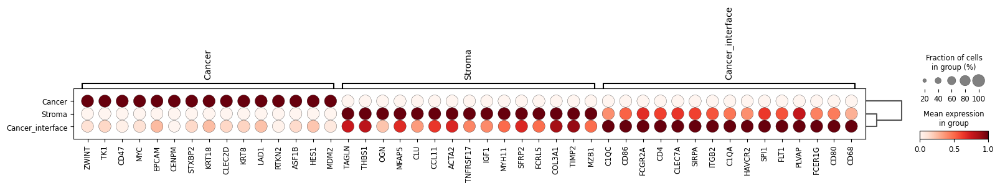

In [23]:
column_name = 'mask_name_combined'
groupcl = adata
groupcl.obs[column_name] = pd.Categorical(
    groupcl.obs[column_name],
    categories=[ 'Stroma','Cancer_interface','Cancer',],
    ordered=True
)

# groupcl.uns['log1p']['base'] = None
sc.tl.rank_genes_groups(groupcl,column_name, method='wilcoxon', pts=True)
sc.tl.filter_rank_genes_groups(groupcl, groupby=column_name, min_fold_change=1)

# Extract the results
result = groupcl.uns['rank_genes_groups']
groups = result['names'].dtype.names

# Create a DataFrame to store the results
results_df = pd.DataFrame()
for group in groups:
    group_df = pd.DataFrame({
        'gene': result['names'][group],
        'logfoldchanges': result['logfoldchanges'][group],
        'pvals': result['pvals'][group],
        'pvals_adj': result['pvals_adj'][group],
        'scores': result['scores'][group]
    })
    group_df['mask'] = group
    results_df = pd.concat([results_df, group_df], ignore_index=True)


dotplot = sc.pl.rank_genes_groups_dotplot(
    groupcl,
    groupby=column_name,
    standard_scale="var",
    n_genes=15,
    dendrogram=True,
    return_fig=True,
#     swap_axes=True,
)
dotplot.savefig('figures/dotplot_highres.png', dpi=500, bbox_inches='tight')
show(results_df)

Plot genes back to 2 core samples

In [24]:
s_genes = results_df[results_df['mask']=='Stroma'].sort_values(by='scores', ascending=False)['gene'][:15]
t_genes = results_df[results_df['mask']=='Cancer'].sort_values(by='scores', ascending=False)['gene'][:15]
tb_genes = results_df[results_df['mask']=='Cancer_interface'].sort_values(by='scores', ascending=False)['gene'][:15]

In [25]:
fig1 = '../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection30_filtered.csv'
fig2 = '../../xenium_data/HLA/GD_TMA1_S3/fov_filtered/TMA1_Selection13_filtered.csv'

df1 = pd.read_csv(fig1)
df1 = df1[['x_location', 'y_location', 'feature_name']]
df1 = df1.rename(columns={'feature_name': 'target'})
df1['X'] = df1['x_location'] - min(df1['x_location'])
df1['Y'] = df1['y_location'] - min(df1['y_location'])
height1 = int(max(df1['X'])) + 1
width1 = int(max(df1['Y'])) + 1
    
df2 = pd.read_csv(fig2)
df2 = df2[['x_location', 'y_location', 'feature_name']]
df2 = df2.rename(columns={'feature_name': 'target'})
df2['X'] = df2['x_location'] - min(df2['x_location'])
df2['Y'] = df2['y_location'] - min(df2['y_location'])
height2 = int(max(df2['X'])) + 1
width2 = int(max(df2['Y'])) + 1


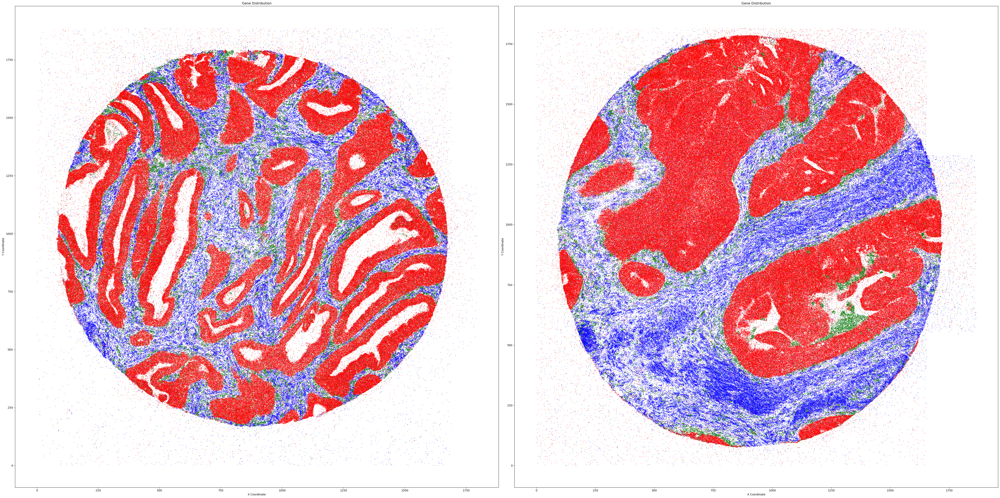

In [33]:
# Function to plot data with color coding
def plot_data(ax, df, s_genes, t_genes, tb_genes):
    # Filter the DataFrame to include only the relevant genes
#     filtered_df = df[df['target'].isin(s_genes + t_genes + tb_genes)]
#     print()
#     # Assign colors based on gene lists
#     colors = filtered_df['target'].apply(
#         lambda gene: 'blue' if gene in s_genes else 'red' if gene in t_genes else 'green'
#     )
    
#     # Plot the filtered data
#     scatter = ax.scatter(filtered_df['X'], filtered_df['Y'], c=colors, s=0.3)  # Adjust 's' for point size
#     # ax.set_facecolor('black')  # Set background to black
#     ax.set_xlabel('X Coordinate')
#     ax.set_ylabel('Y Coordinate')
#     ax.set_title('Gene Distribution')
    s_df = df[df['target'].isin(s_genes)]
    ax.scatter(s_df['X'], s_df['Y'],
                   c='blue',
                   s=0.3, # Default size for blue
                   alpha=0.8, # Default alpha for blue
                   label='Stroma' # Add label for legend
                  )
    t_df = df[df['target'].isin(t_genes)]
    ax.scatter(t_df['X'], t_df['Y'],
                   c='red',
                   s=0.3, # Default size for blue
                   alpha=0.8, 
                   label='Cancer' # Add label for legend
                  )
    ci_df = df[df['target'].isin(tb_genes)]
    ax.scatter(ci_df['X'], ci_df['Y'],
                   c='green',
                   s=0.3,
                   alpha=1.0, 
                   label='Cancer Interface' # Add label for legend
                  )
    # ax.set_facecolor('black')  # Set background to black
    ax.set_xlabel('X Coordinate')
    ax.set_ylabel('Y Coordinate')
    ax.set_title('Gene Distribution')

# Set up the figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(50, 25))

# Plot data for both dataframes
plot_data(ax2, df1, list(s_genes), list(t_genes), list(tb_genes))
plot_data(ax1, df2,list(s_genes), list(t_genes), list(tb_genes))

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

extent1 = ax1.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
fig.savefig('figures/plot1.png', bbox_inches=extent1, dpi=300)

# Save the second subplot
extent2 = ax2.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
fig.savefig('figures/plot2.png', bbox_inches=extent2, dpi=300)

In [26]:
# # Assign colors based on gene lists
# def assign_color(gene):
#     if gene in s_genes2:
#         return 'blue'
#     elif gene in t_genes2:
#         return 'red'
#     elif gene in tb10_genes:
#         return 'darkgreen'
#     elif gene in tb20_genes:
#         return 'lightgreen'
#     else:
#         return 'gray'

# # Assign colors based on gene lists
# def assign_color2(gene):
#     if gene in s_genes:
#         return 'blue'
#     elif gene in t_genes:
#         return 'red'
#     elif gene in tb_genes:
#         return 'green'
#     else:
#         return 'gray'


# def plot_stack(df):
#     # Define the desired order for the masks
#     mask_order = ['Tumour', 'TB_10um', 'TB_20um', 'Stroma', ]
    
#     # Ensure 'mask_name' is treated as a categorical variable with the specified order
#     df['mask_name'] = pd.Categorical(df['mask_name'], categories=mask_order, ordered=True)
    
#     # Calculate densities for each gene list per mask
#     density_sums = {
#         'tumour_genes': df[t_genes].sum(axis=1),
#         'tb10_genes': df[tb10_genes].sum(axis=1),
#         'tb20_genes': df[tb20_genes].sum(axis=1),
#         'stroma_genes': df[s_genes].sum(axis=1),
#     }
    
#     # Create a new DataFrame for plotting
#     df_density = pd.DataFrame(density_sums)
#     df_density['mask_name'] = df['mask_name']
    
#     # Sort the DataFrame by 'mask_name' to ensure correct plotting order
#     df_density = df_density.sort_values('mask_name')
    
#     # Plot
#     ax = df_density.set_index('mask_name').plot(
#         kind='bar', 
#         stacked=True, 
#         color=['red', 'darkgreen','lightgreen',   'blue',], 
#         figsize=(12, 6)
#     )
    
#     # Set plot labels and title
#     ax.set_title('Cumulative Gene Density per Mask Type')
#     ax.set_xlabel('Mask Type')
#     ax.set_ylabel('Cumulative Density')
#     ax.legend(title='Gene List')
    
#     # Display the plot
#     plt.show()
    
# def plot_stack_combined(df):
#     # Define the desired order for the masks
#     mask_order = ['Cancer', 'Cancer_interface','Stroma', ]
    
#     # Ensure 'mask_name' is treated as a categorical variable with the specified order
#     df['mask_name_combined'] = pd.Categorical(df['mask_name_combined'], categories=mask_order, ordered=True)
    
#     # Calculate densities for each gene list per mask
#     density_sums = {
#         'tumour_genes': df[t_genes].sum(axis=1),
#         'tb_genes': df[tb_genes].sum(axis=1),
#         'stroma_genes': df[s_genes].sum(axis=1),
#     }
    
#     # Create a new DataFrame for plotting
#     df_density = pd.DataFrame(density_sums)
#     df_density['mask_name_combined'] = df['mask_name_combined']

#     # Sort the DataFrame by 'mask_name' to ensure correct plotting order
#     df_density = df_density.sort_values('mask_name_combined')
#     df_density = df_density.groupby('mask_name_combined', as_index=False).mean()    # Plot
#     ax = df_density.set_index('mask_name_combined').plot(
#         kind='bar', 
#         stacked=True, 
#         color=['red', 'green', 'blue',], 
#         figsize=(12, 6)
#     )
    
#     # Set plot labels and title
#     ax.set_title('Cumulative Gene Density per Mask Type')
#     ax.set_xlabel('Mask Type')
#     ax.set_ylabel('Cumulative Density')
#     ax.legend(title='Gene List')
    
#     # Display the plot
#     plt.show()


#     # Normalize densities to proportions so that each bar sums to 1
#     df_normalized = df_density.set_index('mask_name_combined')
#     df_normalized = df_normalized.div(df_normalized.sum(axis=1), axis=0)
    
#     # Plot
#     ax = df_normalized.plot(
#         kind='bar', 
#         stacked=True, 
#         color=['red', 'green', 'blue'], 
#         figsize=(12, 6),
#         legend=False
#     )

#     ax.set_title('Cumulative Gene Density per Mask Type')
#     ax.set_xlabel('Mask Type')
#     ax.set_ylabel('Cumulative Density')
#     plt.show()


# results = save_path_
# df1 = pd.read_csv(f'{results}/TMA1_Selection30/TMA1_Selection30_tb.csv')
# df2 = pd.read_csv(f'{results}/TMA1_Selection13/TMA1_Selection13_tb.csv')

# obs_columns = ['area', 'perimeter', 'centroid', 'min_x', 'min_y', 'max_x', 'max_y', 'vertices', 'BoundingBox', 'mask_name',
#                'per_object', 'selection','object_id']

# gene_columns = [col for col in df1.columns if col not in obs_columns]

# df1[gene_columns] = df1[gene_columns].div(df1['area'], axis=0)
# df1['mask_name_combined'] = df1['mask_name'].replace(combined_replacements).astype('category')

# # print(df1)
# # # plot_stack(df1)
# plot_stack_combined(df1)


# # gene_columns = [col for col in df2.columns if col not in obs_columns]

# # df2[gene_columns] = df2[gene_columns].div(df2['area'], axis=0)
# df2['mask_name_combined'] = df2['mask_name'].replace(combined_replacements).astype('category')
# plot_stack_combined(df2)

# Considerations 

Have some doubts that this is the ideal way to do this 

the analyisis should be more robust  - regions have very different sizes and we have very few . Still thinking to try if we subdivide the areas in a large number of small areas and use that. 
Dont know how real this differeences are 

Dont know if we should do this in a paired away somehow. The masks that came from the same core. so the difference across stroma and epi and TB ? 


Shoudl we check how the TB change from the tumour bject it cames 